In [1]:
%matplotlib inline

In [2]:
import os

# Tutorial for SMA Data Calibration in CASA #

**Authors: [Eric Koch](https://github.com/e-koch), [Karto Keating](https://github.com/kartographer), and...**

Based on scripts from Charlie Qi and Todd Hunter.


## Purpose

This tutorial provides an overview for calibrating SMA data using CASA.

Our tutorial data set is of the protoplanetary disk HD163296. The observations were taken on 2023/04/24 with the SMA's rx230 and rx240 receivers.


## Using this tutorial with CASA ##

CASA is typically run from a terminal with information sent to the CASA logger, a separate window with the log file displayed. We recommend running this tutorial by opening the normal CASA terminal and copy-pasting the tutorial code in. This is easier to handle CASA's GUI applications (the logger, plotms, imview).

We use the notebook format here to include plots and example interleaved with the code.

*Alternatively (and not recommended)* you can load the CASA log within the jupyter lab environment and place a tile within the browser (drag the log file from the folder listing on the left into the notebook). However, jupyter's text editor does not yet have the capability to re-load, and so new lines will not be updated in the text editor view of the log. You can open and close (which is tedious) or open the log file in a separate text editor that handles reloading (for example, VSCode).

## Installing CASA ##

**Working in the normal CASA terminal**: Install the [monolithic CASA distribution](https://casadocs.readthedocs.io/en/stable/notebooks/introduction.html#Monolithic-Distribution) (this remains the CASA team's recommended option).

**Working with modular CASA (this tutorial in a notebook):** Install the [modular distribution via pip install](https://casadocs.readthedocs.io/en/stable/notebooks/introduction.html#Modular-Packages).

## Review the observing log ##

There will be a log for every SMA observation taken for your project on the SMAOC website. It is highly useful to review the operator's logs to check for any systematic issues that may have arisen through the night.

Here's the log for the tutorial data set:

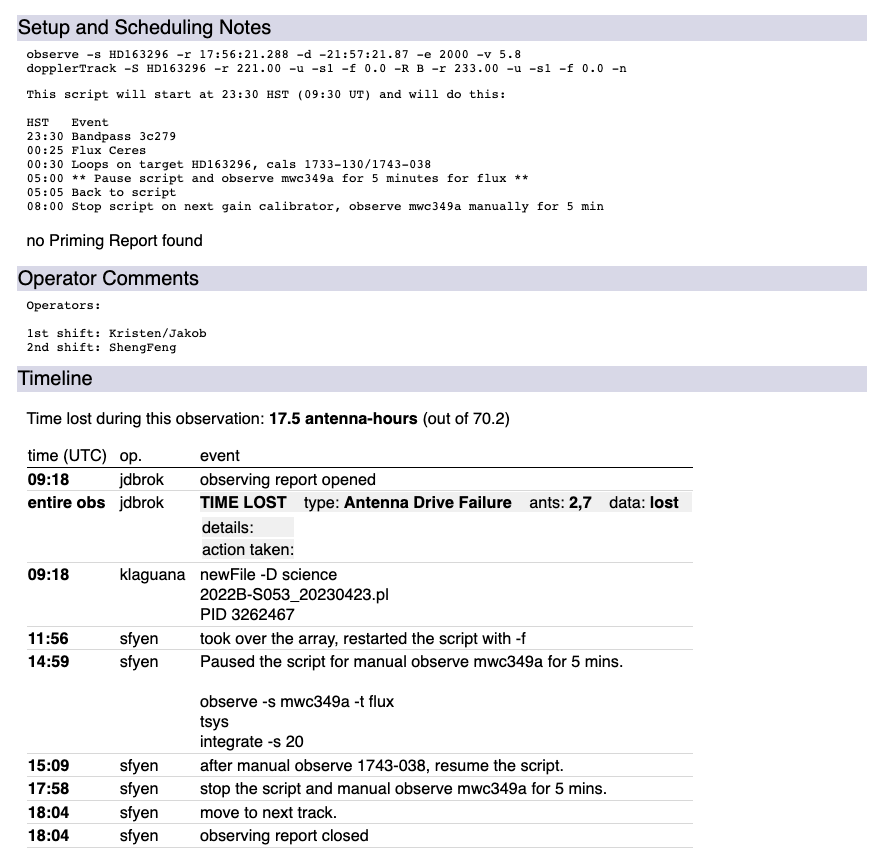

The key thing to note is that 2 antennas were not included in the array that night, so we expect that 6 antennas will be recorded in our data set.

Otherwise, no other crucial issues are noted.

## Initial Steps: converting the MIR format to a CASA Measurement Set ##

The native MIR format for SMA can be converted to a CASA measurement set (MS) using the [pyuvdata](pyuvdata.readthedocs.io) python package. Currently, this conversion handles two common operations on the data: 

* pyuvdata can "rechunk" the SMA data by spectrally averaging the uncalibrate visbilities. SMA observations with the upgraded SWARM correlator observe a fixed spectral resolution of 140 kHz, however, most science applications do not need such fine sampling. By rechunking (typically by powers of 2), we can reduce the data volume considerably.
* pyuvdata applies the system temperature correction ($T_{\rm sys}$) to the raw cross-correlation data. This means the uncalibrated visibilities saved to the MS file will be in Jy units already, but typically underestimated from the true sky brightness due to uncorrected inefficiencies (i.e., we still apply an absolute flux scaling factor from a known calibrator source, usually a Solar System object).

For this tutorial, we have already used pyuvdata to convert to a measurement set using the example code below, where we have rechunked the data by a factor of 8:

```
from pyuvdata import UVData

mir_filename = "FILENAME"
rechunk_factor = 8  # Set to desired spectral chunking (avg. over 8 here).

uv_data = UVData()
uv_data.read(filename, rechunk=rechunk_factor)

# We suggest labeling the MS by the rechunk factor
uv_data.write_ms(f"{mir_filename}_bin{rechunk_factor}.ms")

```

## CASA Data Calibration ##



In [3]:
# Import the CASA tasks and programs we'll need:

from casatasks import (listobs, clearcal, flagmanager, flagdata,
                       setjy, bandpass, gaincal, applycal, blcal, fluxscale)
from casaplotms import plotms

You appear to be importing analysisUtils into python (not CASA). version =  3.8.12
CASAPATH is not defined, so I am skipping a lot of imports


After running the above import, you should see a new CASA log file in the folder you've opened CASA in: `casa-YYYMMDD-HHMMSS.log`

To avoid having to remember the MS name, we will defined it here at the start as `myvis`:

In [3]:
myvis = '230424_09:18:48_bin8.ms'

### What's in the data? ###

Start by inspecting what is contained in the data set. CASA's `listobs` function will print out a long summary.

In [5]:
out = listobs(myvis)

For our tutorial data set, you should see the following printed by the CASA logger:
```
2023-05-10 21:07:55	INFO	listobs::::casa	##########################################
2023-05-10 21:07:55	INFO	listobs::::casa	##### Begin Task: listobs            #####
2023-05-10 21:07:55	INFO	listobs::::casa	listobs( vis='230424_09:18:48_bin8.ms', selectdata=True, spw='', field='', antenna='', uvrange='', timerange='', correlation='', scan='', intent='', feed='', array='', observation='', verbose=True, listfile='', listunfl=False, cachesize=50.0, overwrite=False )
2023-05-10 21:07:55	INFO	listobs::ms::summary	================================================================================
2023-05-10 21:07:55	INFO	listobs::ms::summary+	           MeasurementSet Name:  /Users/ekoch/storage/SMASchool_Tutorial/230424_09:18:48_bin8.ms      MS Version 2
2023-05-10 21:07:55	INFO	listobs::ms::summary+	================================================================================
2023-05-10 21:07:55	INFO	listobs::ms::summary+	   Observer: SMA     Project:   
2023-05-10 21:07:55	INFO	listobs::ms::summary+	Observation: SMA
2023-05-10 21:07:55	INFO	listobs::MSMetaData::_computeScanAndSubScanProperties 	Computing scan and subscan properties...
2023-05-10 21:07:56	INFO	listobs::ms::summary	Data records: 712080       Total elapsed time = 31528.9 seconds
2023-05-10 21:07:56	INFO	listobs::ms::summary+	   Observed from   24-Apr-2023/09:18:29.7   to   24-Apr-2023/18:03:58.6 (UTC)
2023-05-10 21:07:56	INFO	listobs::ms::summary	
2023-05-10 21:07:56	INFO	listobs::ms::summary+	   ObservationID = 0         ArrayID = 0
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  Date        Timerange (UTC)          Scan  FldId FieldName             nRows     SpwIds   Average Interval(s)    ScanIntent
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  24-Apr-2023/09:18:29.7 - 09:18:59.4     1      0 1159+292                   360  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              09:20:58.1 - 10:08:49.6     2      1 3c279                    64800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              10:09:19.3 - 10:16:44.5     3      2 Ceres                    10800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              10:17:43.9 - 10:24:16.9     4      3 1733-130                  4320  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              10:24:31.7 - 10:44:19.0     5      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              10:44:33.9 - 10:46:02.9     6      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              10:46:17.7 - 11:06:05.1     7      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:06:19.9 - 11:07:48.9     8      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:08:03.8 - 11:09:32.8     9      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:09:47.7 - 11:29:35.0    10      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:29:49.8 - 11:31:18.9    11      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:31:33.7 - 11:51:21.0    12      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:51:35.9 - 11:53:04.9    13      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:53:19.8 - 11:55:03.6    14      3 1733-130                  2520  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              11:55:18.5 - 12:15:05.8    15      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              12:15:20.6 - 12:21:53.6    16      3 1733-130                  4320  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              12:22:08.5 - 12:41:55.8    17      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              12:42:10.6 - 12:43:39.7    18      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              12:43:54.5 - 12:45:23.5    19      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              12:45:38.4 - 13:05:25.7    20      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              13:05:40.5 - 13:07:09.6    21      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              13:07:24.4 - 13:27:11.7    22      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              13:27:26.6 - 13:28:55.6    23      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              13:29:10.5 - 13:30:39.5    24      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              13:30:54.4 - 13:50:41.7    25      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              13:50:56.5 - 13:52:25.6    26      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              13:52:40.4 - 14:12:27.7    27      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              14:12:42.6 - 14:14:11.6    28      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              14:14:26.4 - 14:15:55.5    29      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              14:16:10.3 - 14:35:57.6    30      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              14:36:12.5 - 14:37:41.5    31      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              14:37:56.4 - 14:57:43.7    32      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              14:57:58.5 - 14:59:27.6    33      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:00:41.8 - 15:05:38.6    34      6 mwc349a                   7200  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:06:52.8 - 15:10:20.6    35      5 1743-038                  5040  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:10:50.3 - 15:12:19.3    36      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:12:34.2 - 15:32:21.5    37      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:32:36.3 - 15:34:05.4    38      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:37:40.2 - 15:57:27.6    39      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:57:42.4 - 15:59:11.4    40      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              15:59:26.3 - 16:00:55.3    41      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              16:01:10.2 - 16:20:57.5    42      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              16:21:12.3 - 16:22:41.4    43      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              16:22:56.2 - 16:42:43.5    44      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              16:42:58.4 - 16:49:31.3    45      5 1743-038                  4320  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              16:49:46.2 - 16:51:15.2    46      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              16:51:30.1 - 17:11:17.4    47      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              17:11:32.2 - 17:13:01.3    48      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              17:13:16.1 - 17:33:03.4    49      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              17:33:18.3 - 17:34:47.3    50      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              17:35:02.2 - 17:36:31.2    51      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              17:36:46.0 - 17:56:33.4    52      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              17:56:48.2 - 17:58:17.2    53      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	              17:59:01.8 - 18:03:58.6    54      6 mwc349a                   7200  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:07:56	INFO	listobs::ms::summary	           (nRows = Total number of rows per scan) 
2023-05-10 21:07:56	INFO	listobs::ms::summary	Fields: 7
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  ID   Code Name                RA               Decl           Epoch   SrcId      nRows
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  0         1159+292            11:59:31.834000 +29.14.43.82600 J2000   1            360
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  1         3c279               12:56:11.166000 -05.47.21.52400 J2000   2          64800
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  2         Ceres               12:02:29.094450 +16.05.10.59563 ICRS    3          10800
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  3         1733-130            17:33:02.706000 -13.04.49.54800 J2000   4          47880
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  4         HD163296            17:56:21.288000 -21.57.21.87000 J2000   5         547200
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  5         1743-038            17:43:58.856000 -03.50.04.61600 J2000   6          26640
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  6         mwc349a             20:32:45.540000 +40.39.36.61100 J2000   7          14400
2023-05-10 21:07:56	INFO	listobs::ms::summary	Spectral Windows:  (24 unique spectral windows and 2 unique polarization setups)
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  SpwID  Name   #Chans   Frame   Ch0(MHz)  ChanWid(kHz)  TotBW(kHz) CtrFreq(MHz)  Corrs
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  0      SPW-6    2048   TOPO  199873.659      1117.188   2288000.0 201017.1007   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  1      SPW-5    2048   TOPO  204172.682      1117.188   2288000.0 203029.2404   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  2      SPW-4    2048   TOPO  203873.659      1117.188   2288000.0 205017.1007   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  3      SPW-3    2048   TOPO  208172.682      1117.188   2288000.0 207029.2404   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  4      SPW-2    2048   TOPO  207873.659      1117.188   2288000.0 209017.1007   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  5      SPW-1    2048   TOPO  212172.682      1117.188   2288000.0 211029.2404   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  6      SPW1     2048   TOPO  219873.659      1117.188   2288000.0 221017.1007   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  7      SPW2     2048   TOPO  224172.682      1117.188   2288000.0 223029.2404   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  8      SPW3     2048   TOPO  223873.659      1117.188   2288000.0 225017.1007   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  9      SPW4     2048   TOPO  228172.682      1117.188   2288000.0 227029.2404   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  10     SPW5     2048   TOPO  227873.659      1117.188   2288000.0 229017.1007   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  11     SPW6     2048   TOPO  232172.682      1117.188   2288000.0 231029.2404   XX
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  12     SPW506   2048   TOPO  211874.917      1117.188   2288000.0 213018.3589   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  13     SPW507   2048   TOPO  216173.940      1117.188   2288000.0 215030.4985   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  14     SPW508   2048   TOPO  215874.917      1117.188   2288000.0 217018.3589   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  15     SPW509   2048   TOPO  220173.940      1117.188   2288000.0 219030.4985   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  16     SPW510   2048   TOPO  219874.917      1117.188   2288000.0 221018.3589   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  17     SPW511   2048   TOPO  224173.940      1117.188   2288000.0 223030.4985   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  18     SPW513   2048   TOPO  231874.917      1117.188   2288000.0 233018.3589   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  19     SPW514   2048   TOPO  236173.940      1117.188   2288000.0 235030.4985   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  20     SPW515   2048   TOPO  235874.917      1117.188   2288000.0 237018.3589   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  21     SPW516   2048   TOPO  240173.940      1117.188   2288000.0 239030.4985   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  22     SPW517   2048   TOPO  239874.917      1117.188   2288000.0 241018.3589   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  23     SPW518   2048   TOPO  244173.940      1117.188   2288000.0 243030.4985   YY
2023-05-10 21:07:56	INFO	listobs::ms::summary	Sources: 7
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  ID   Name                SpwId RestFreq(MHz)  SysVel(km/s) 
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  1    1159+292            any   -              -            
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  2    3c279               any   -              -            
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  3    Ceres               any   -              -            
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  4    1733-130            any   -              -            
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  5    HD163296            any   -              -            
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  6    1743-038            any   -              -            
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  7    mwc349a             any   -              -            
2023-05-10 21:07:56	INFO	listobs::ms::summary	Antennas: 6:
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  ID   Name  Station   Diam.    Long.         Lat.                Offset from array center (m)                ITRF Geocentric coordinates (m)        
2023-05-10 21:07:56	INFO	listobs::ms::summary+	                                                                     East         North     Elevation               x               y               z
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  1    Ant1  Ant1      6.0  m   -155.28.39.8  +19.42.06.0        -20.1497   -13648.4593    -2468.4415 -5464541.666377 -2492902.458485  2150769.379487
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  3    Ant3  Ant3      6.0  m   -155.28.40.9  +19.42.05.2        -53.7258   -13675.0318    -2471.0345 -5464561.533303 -2492874.602586  2150743.497991
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  4    Ant4  Ant4      6.0  m   -155.28.39.7  +19.42.07.1        -19.0575   -13616.0917    -2468.4642 -5464531.269670 -2492898.916433  2150799.832803
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  5    Ant5  Ant5      6.0  m   -155.28.41.4  +19.42.06.7        -68.0562   -13627.1312    -2473.1592 -5464550.977154 -2492854.029947  2150787.860803
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  6    Ant6  Ant6      6.0  m   -155.28.39.1  +19.42.06.6         -0.0812   -13632.7167    -2468.3599 -5464528.577098 -2492918.553728  2150784.222301
2023-05-10 21:07:56	INFO	listobs::ms::summary+	  8    Ant8  Ant8      6.0  m   -155.28.39.9  +19.42.06.6        -25.2222   -13631.3393    -2468.4058 -5464538.554174 -2492895.461206  2150785.503044
2023-05-10 21:07:56	INFO	listobs::::casa	Task listobs complete. Start time: 2023-05-10 17:07:55.090822 End time: 2023-05-10 17:07:55.918963
2023-05-10 21:07:56	INFO	listobs::::casa	##### End Task: listobs              #####
2023-05-10 21:07:56	INFO	listobs::::casa	##########################################
2023-05-10 21:08:05	INFO	listobs::::casa	##########################################
2023-05-10 21:08:05	INFO	listobs::::casa	##### Begin Task: listobs            #####
2023-05-10 21:08:05	INFO	listobs::::casa	listobs( vis='230424_09:18:48_bin8.ms', selectdata=True, spw='', field='', antenna='', uvrange='', timerange='', correlation='', scan='', intent='', feed='', array='', observation='', verbose=True, listfile='', listunfl=False, cachesize=50.0, overwrite=False )
2023-05-10 21:08:05	INFO	listobs::ms::summary	================================================================================
2023-05-10 21:08:05	INFO	listobs::ms::summary+	           MeasurementSet Name:  /Users/ekoch/storage/SMASchool_Tutorial/230424_09:18:48_bin8.ms      MS Version 2
2023-05-10 21:08:05	INFO	listobs::ms::summary+	================================================================================
2023-05-10 21:08:05	INFO	listobs::ms::summary+	   Observer: SMA     Project:   
2023-05-10 21:08:05	INFO	listobs::ms::summary+	Observation: SMA
2023-05-10 21:08:05	INFO	listobs::MSMetaData::_computeScanAndSubScanProperties 	Computing scan and subscan properties...
2023-05-10 21:08:05	INFO	listobs::ms::summary	Data records: 712080       Total elapsed time = 31528.9 seconds
2023-05-10 21:08:05	INFO	listobs::ms::summary+	   Observed from   24-Apr-2023/09:18:29.7   to   24-Apr-2023/18:03:58.6 (UTC)
2023-05-10 21:08:05	INFO	listobs::ms::summary	
2023-05-10 21:08:05	INFO	listobs::ms::summary+	   ObservationID = 0         ArrayID = 0
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  Date        Timerange (UTC)          Scan  FldId FieldName             nRows     SpwIds   Average Interval(s)    ScanIntent
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  24-Apr-2023/09:18:29.7 - 09:18:59.4     1      0 1159+292                   360  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7, 29.7] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              09:20:58.1 - 10:08:49.6     2      1 3c279                    64800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              10:09:19.3 - 10:16:44.5     3      2 Ceres                    10800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              10:17:43.9 - 10:24:16.9     4      3 1733-130                  4320  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              10:24:31.7 - 10:44:19.0     5      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              10:44:33.9 - 10:46:02.9     6      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              10:46:17.7 - 11:06:05.1     7      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:06:19.9 - 11:07:48.9     8      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:08:03.8 - 11:09:32.8     9      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:09:47.7 - 11:29:35.0    10      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:29:49.8 - 11:31:18.9    11      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:31:33.7 - 11:51:21.0    12      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:51:35.9 - 11:53:04.9    13      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:53:19.8 - 11:55:03.6    14      3 1733-130                  2520  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              11:55:18.5 - 12:15:05.8    15      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              12:15:20.6 - 12:21:53.6    16      3 1733-130                  4320  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              12:22:08.5 - 12:41:55.8    17      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              12:42:10.6 - 12:43:39.7    18      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              12:43:54.5 - 12:45:23.5    19      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              12:45:38.4 - 13:05:25.7    20      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              13:05:40.5 - 13:07:09.6    21      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              13:07:24.4 - 13:27:11.7    22      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              13:27:26.6 - 13:28:55.6    23      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              13:29:10.5 - 13:30:39.5    24      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              13:30:54.4 - 13:50:41.7    25      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              13:50:56.5 - 13:52:25.6    26      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              13:52:40.4 - 14:12:27.7    27      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              14:12:42.6 - 14:14:11.6    28      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              14:14:26.4 - 14:15:55.5    29      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              14:16:10.3 - 14:35:57.6    30      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              14:36:12.5 - 14:37:41.5    31      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              14:37:56.4 - 14:57:43.7    32      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              14:57:58.5 - 14:59:27.6    33      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:00:41.8 - 15:05:38.6    34      6 mwc349a                   7200  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:06:52.8 - 15:10:20.6    35      5 1743-038                  5040  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:10:50.3 - 15:12:19.3    36      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:12:34.2 - 15:32:21.5    37      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:32:36.3 - 15:34:05.4    38      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:37:40.2 - 15:57:27.6    39      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:57:42.4 - 15:59:11.4    40      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              15:59:26.3 - 16:00:55.3    41      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              16:01:10.2 - 16:20:57.5    42      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              16:21:12.3 - 16:22:41.4    43      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              16:22:56.2 - 16:42:43.5    44      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              16:42:58.4 - 16:49:31.3    45      5 1743-038                  4320  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              16:49:46.2 - 16:51:15.2    46      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              16:51:30.1 - 17:11:17.4    47      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              17:11:32.2 - 17:13:01.3    48      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              17:13:16.1 - 17:33:03.4    49      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              17:33:18.3 - 17:34:47.3    50      5 1743-038                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              17:35:02.2 - 17:36:31.2    51      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              17:36:46.0 - 17:56:33.4    52      4 HD163296                 28800  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              17:56:48.2 - 17:58:17.2    53      3 1733-130                  2160  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	              17:59:01.8 - 18:03:58.6    54      6 mwc349a                   7200  [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]  [14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8, 14.8] 
2023-05-10 21:08:05	INFO	listobs::ms::summary	           (nRows = Total number of rows per scan) 
2023-05-10 21:08:05	INFO	listobs::ms::summary	Fields: 7
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  ID   Code Name                RA               Decl           Epoch   SrcId      nRows
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  0         1159+292            11:59:31.834000 +29.14.43.82600 J2000   1            360
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  1         3c279               12:56:11.166000 -05.47.21.52400 J2000   2          64800
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  2         Ceres               12:02:29.094450 +16.05.10.59563 ICRS    3          10800
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  3         1733-130            17:33:02.706000 -13.04.49.54800 J2000   4          47880
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  4         HD163296            17:56:21.288000 -21.57.21.87000 J2000   5         547200
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  5         1743-038            17:43:58.856000 -03.50.04.61600 J2000   6          26640
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  6         mwc349a             20:32:45.540000 +40.39.36.61100 J2000   7          14400
2023-05-10 21:08:05	INFO	listobs::ms::summary	Spectral Windows:  (24 unique spectral windows and 2 unique polarization setups)
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  SpwID  Name   #Chans   Frame   Ch0(MHz)  ChanWid(kHz)  TotBW(kHz) CtrFreq(MHz)  Corrs
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  0      SPW-6    2048   TOPO  199873.659      1117.188   2288000.0 201017.1007   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  1      SPW-5    2048   TOPO  204172.682      1117.188   2288000.0 203029.2404   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  2      SPW-4    2048   TOPO  203873.659      1117.188   2288000.0 205017.1007   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  3      SPW-3    2048   TOPO  208172.682      1117.188   2288000.0 207029.2404   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  4      SPW-2    2048   TOPO  207873.659      1117.188   2288000.0 209017.1007   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  5      SPW-1    2048   TOPO  212172.682      1117.188   2288000.0 211029.2404   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  6      SPW1     2048   TOPO  219873.659      1117.188   2288000.0 221017.1007   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  7      SPW2     2048   TOPO  224172.682      1117.188   2288000.0 223029.2404   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  8      SPW3     2048   TOPO  223873.659      1117.188   2288000.0 225017.1007   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  9      SPW4     2048   TOPO  228172.682      1117.188   2288000.0 227029.2404   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  10     SPW5     2048   TOPO  227873.659      1117.188   2288000.0 229017.1007   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  11     SPW6     2048   TOPO  232172.682      1117.188   2288000.0 231029.2404   XX
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  12     SPW506   2048   TOPO  211874.917      1117.188   2288000.0 213018.3589   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  13     SPW507   2048   TOPO  216173.940      1117.188   2288000.0 215030.4985   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  14     SPW508   2048   TOPO  215874.917      1117.188   2288000.0 217018.3589   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  15     SPW509   2048   TOPO  220173.940      1117.188   2288000.0 219030.4985   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  16     SPW510   2048   TOPO  219874.917      1117.188   2288000.0 221018.3589   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  17     SPW511   2048   TOPO  224173.940      1117.188   2288000.0 223030.4985   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  18     SPW513   2048   TOPO  231874.917      1117.188   2288000.0 233018.3589   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  19     SPW514   2048   TOPO  236173.940      1117.188   2288000.0 235030.4985   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  20     SPW515   2048   TOPO  235874.917      1117.188   2288000.0 237018.3589   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  21     SPW516   2048   TOPO  240173.940      1117.188   2288000.0 239030.4985   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  22     SPW517   2048   TOPO  239874.917      1117.188   2288000.0 241018.3589   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  23     SPW518   2048   TOPO  244173.940      1117.188   2288000.0 243030.4985   YY
2023-05-10 21:08:05	INFO	listobs::ms::summary	Sources: 7
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  ID   Name                SpwId RestFreq(MHz)  SysVel(km/s) 
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  1    1159+292            any   -              -            
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  2    3c279               any   -              -            
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  3    Ceres               any   -              -            
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  4    1733-130            any   -              -            
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  5    HD163296            any   -              -            
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  6    1743-038            any   -              -            
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  7    mwc349a             any   -              -            
2023-05-10 21:08:05	INFO	listobs::ms::summary	Antennas: 6:
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  ID   Name  Station   Diam.    Long.         Lat.                Offset from array center (m)                ITRF Geocentric coordinates (m)        
2023-05-10 21:08:05	INFO	listobs::ms::summary+	                                                                     East         North     Elevation               x               y               z
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  1    Ant1  Ant1      6.0  m   -155.28.39.8  +19.42.06.0        -20.1497   -13648.4593    -2468.4415 -5464541.666377 -2492902.458485  2150769.379487
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  3    Ant3  Ant3      6.0  m   -155.28.40.9  +19.42.05.2        -53.7258   -13675.0318    -2471.0345 -5464561.533303 -2492874.602586  2150743.497991
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  4    Ant4  Ant4      6.0  m   -155.28.39.7  +19.42.07.1        -19.0575   -13616.0917    -2468.4642 -5464531.269670 -2492898.916433  2150799.832803
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  5    Ant5  Ant5      6.0  m   -155.28.41.4  +19.42.06.7        -68.0562   -13627.1312    -2473.1592 -5464550.977154 -2492854.029947  2150787.860803
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  6    Ant6  Ant6      6.0  m   -155.28.39.1  +19.42.06.6         -0.0812   -13632.7167    -2468.3599 -5464528.577098 -2492918.553728  2150784.222301
2023-05-10 21:08:05	INFO	listobs::ms::summary+	  8    Ant8  Ant8      6.0  m   -155.28.39.9  +19.42.06.6        -25.2222   -13631.3393    -2468.4058 -5464538.554174 -2492895.461206  2150785.503044
2023-05-10 21:08:05	INFO	listobs::::casa	Task listobs complete. Start time: 2023-05-10 17:08:04.780816 End time: 2023-05-10 17:08:05.419178
2023-05-10 21:08:05	INFO	listobs::::casa	##### End Task: listobs              #####
2023-05-10 21:08:05	INFO	listobs::::casa	##########################################
```

There's a lot of info here! The listobs output is a useful resource to return to check: when a source is observed (first section), which sources are in the data (second section), the spectral coverage or "windows" (third section), another summary of the sources (with rest frequency and systemic velocity, when available; fourth section), and the antennas in the array for this observation (last section).

From this information, along with knowledge of how the observations were set up (which *you* as the scientist would have done for your own observations!), we can define the purpose of each source for calibration.

In this observation, we have 7 sources:

* Our science target: HD163296
* Flux calibrator: Ceres (flux calibrators are typically Solar System objects; usually observed once per night, sometimes multiple objects will be observed)
* Bandpass calibrator 3c279 (bandpass calibrators are typically one of the brightest quasars accessible at the time of the observation; usually observed once per night)
* Gain calibrators: 1743-038, 1733-130 (quasars near to the target that are interwoven with observations on the science target)

There may be extra sources in the observation! In this case `mwc349a` could be used as a backup flux calibrator. Occasionally another quasar source will show up in the data that was used for pointing corrections through the night, though typically that data will be flagged.

We will define each of the sources as their own variable:

In [4]:
# variable names for the sources are case sensitive
flux = 'Ceres'

bpcal= '3c279'

# Gain calibrators
# NOTE: SMA observations often have 2 gain calibrators. If you only have one, comment out `pcal2' and remove its
# use in `bothpcal`. Similarly, you *could* have more than two, in which case add a `pcal3` and add to `bothpcal`
#  ppropriate!
pcal1 = '1743-038'
pcal2= '1733-130'
# A variable to use both gain cals
bothpcal = f"{pcal1},{pcal2}"

# A variable with all the calibrator names for convenience later
calfields= ",".join([bpcal, bothpcal, flux])

# If you have more than 1 science field, separate the source names by a comma in the string.
science_fields = 'HD163296'

Another pertinent piece of information is the spectral windows that tells us the spectral coverage of these observations. For SMA observations since ~2021, each receiver has 12 GHz sideband split into 6 spectral windows covering 2 GHz each. Each 2 GHz "chunk" is a spectral window (SPW) in CASA.

Each SMA receiver has 2 sidebands, so 12 SPWs per receiver.

And 2 receivers operate at one time, so 24 SPWs altogether.

*Dual receiver mode* - Each SMA receiver is recording a single polarization (*when not in polarization mode*) and the receiver pair can be tuned together to give the YY and XX dual polarization at the same frequencies. With dual receiver tuning, the MS file will only have 12 SPWs, but each will have the YY and XX polarization listed in the listobs output above.

*Split tuning mode* - When each SMA receiver is tuned to a different local oscillator (LO) frequency, there will be 24 SPWs, each with a single polarization. Depending on the tuning, a frequency range may still have dual polarization coverage, but the SPWs from each receiver will not align in frequency like in dual receiver mode (see above). **This is the mode this tutorial data set is taken in!** The SPW numbers range from 0 to 23.

Before we get started, we will make a backup of the original flags applied using the [`flagmanager`](https://casadocs.readthedocs.io/en/stable/api/tt/casatasks.flagging.flagmanager.html) task in case we want to restart the process from scratch.

In [8]:
flagmanager(vis=myvis, mode='save', versionname='original')

2023-05-11 18:06:47	WARN	flagmanager::::casa	Version name 'original' already exist. Will rename it to original.old.1683828406


### Visually inspecting the data, and intro to manual flagging ###

It's helpful to visually inspect the data to know what is in the raw visibilities and to identify systematic issues that should be flagged prior to data calibration. CASA plotms is the tool for this task.

*NOTE: We are assuming that the plotms window will open separately in your desktop, not in the jupyter environment. If you are running this in jupyter and nothing is shown, see [this tutorial](https://casadocs.readthedocs.io/en/stable/examples/community/jupyter_and_x11.html).*

To quickly check the data, we will plot the averaged time-amplitude vs. spectral channel using plotms of the bandpass calibrator:

In [28]:
plotms(vis=myvis, xaxis='channel',
       yaxis='amp',field=bpcal, avgtime='1e8', avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=4, gridcols=3, yselfscale=True)

In a separate window, you should see something that looks like this:

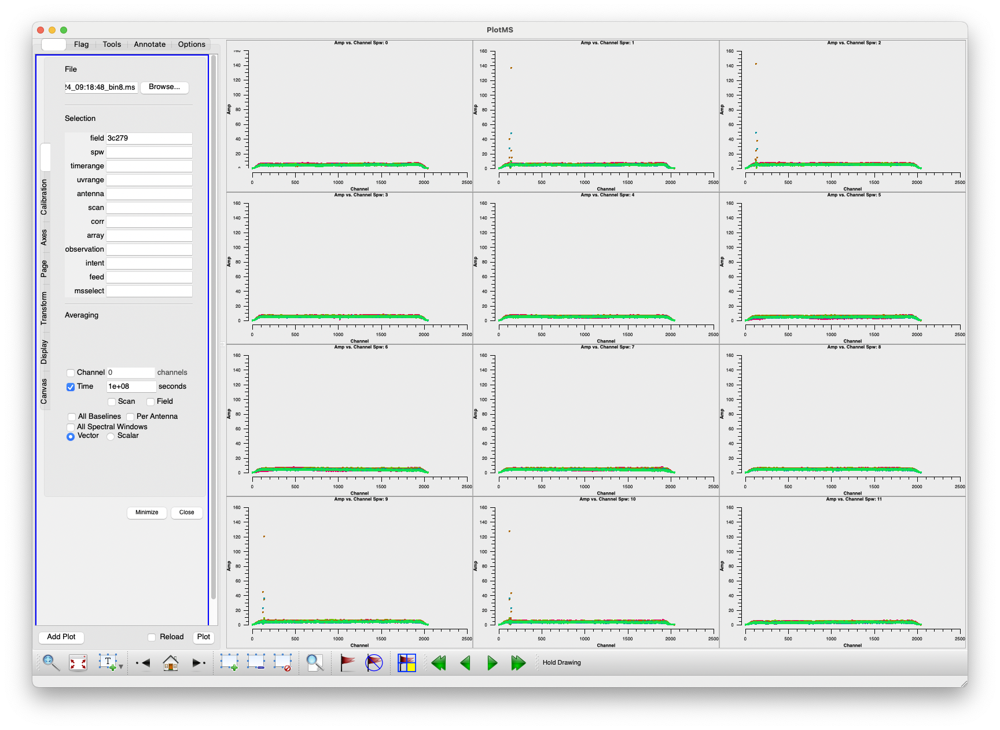

This plot is showing multiple things:

* each subplot is for 1 spectral window. The entire view shows 12 SPWs that is the coverage of 1 of the receivers. (`iteraxis='spw`)
* the color corresponds to the first antenna in the baseline for each visibility (`coloraxis='ant1'`)
* to see the SPWs for the 2nd receiver, hit the "play" button in the bottom tool bar; this will cause the window to re-draw and show the other 12 SPWs.

The y axes share a common scaling (`yselfscale=True`) which is helpful to catch pesky amplitude outliers. In this case, we see there are a few groups of high amplitude outliers. These are very likely a systematic issue when recording the data at particular frequencies. Because of this, we will flag these point as "bad" to exclude their use in the calibration steps.

For this flagging, we use CASA's [`flagdata`](https://casadocs.readthedocs.io/en/stable/api/tt/casatasks.flagging.flagdata.html) task.

To manually flag the data, we at least need to know (a) which SPW it is in, and (b) the range of channels the spike corresponds to.

*NOTE: you can approach this in a more careful manner by ALSO flagging only individual antenna, baselines, or time ranges where/when the spike occurs. The important of thise really depends on the science goal and whether or not you may have a spectral line at those corresponding frequencies. In our case, we will simply flag that range for this source (3c279) as it is a miniscule loss of continuum sensitivity (the spectral range is a small fraction of the total bandwidth).*

plotms allows us to do this interactively. Select the magnifying glass on the left side of the bottom tool bar, and use it draw a box over one of the subplots to zoom in. Keep zooming in until (a) you can read the channel range from the x-axis, or (b) you can highlight those points and print a summary to the logger. Method (b): on the bottom tool bar, select the box with the green "+", draw a box around the point you want to highlight (in this case, the amplitude outliers) and, again on the bottom tool bar, click the magnifying glass in front of the white rectangle (to the right of the box with the green "+" you just clicked). Now check the logger. It should give you a summary of the selected visibility points.

For our purposes here, we will use option (a) to zoom in and look at the x-axis range.

Choosing SPW 1 (top center panel), we find the affected channel range is SPW 1 from channels X~Y. We can flag that data using the following:

In [9]:
flagdata(vis=myvis, mode='manual', spw='1:127', flagbackup=False) # We'll save a flag version after all manual flagging is done
flagdata(vis=myvis, mode='manual', spw='1:143', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='1:151', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='1:134~136', flagbackup=False) # Flag a range from 134 to 136

{}

To see the effect of the flagging, click the "reload" button in the plotms window

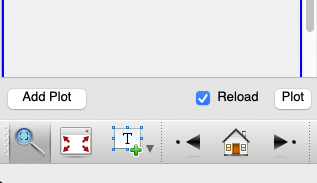

and press plot.

We should now see those channels "missing" in the reloaded plot:

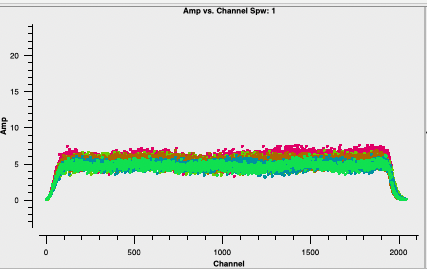

Systematic amplitude spikes are often symmetric in both sidebands. SPW 1 that we flagged above is the 5th "chunk" from the local oscillator frequency in the *lower sideband*. The corresponding 5th chunk in the *upper sideband* is SPW 10 for this receiver. To check this, next zoom into the spikes in SPW 10. You should find that they correspond to the same channel numbers.

When these spikes are symmetrically offset about the local oscillator, we can flag the bad channels in a moderately more efficient way by specifying both SPW numbers to `flagdata`:

In [10]:
flagdata(vis=myvis, mode='manual', spw='1:127,10:127', flagbackup=False) # We'll save a flag version after all manual flagging is done
flagdata(vis=myvis, mode='manual', spw='1:143,10:143', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='1:151,10:151', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='1:134~136,10:134~136', flagbackup=False) # Flag a range from 134 to 136

{}

Try reloading the plot again. You should see the spikes gone in both SPWs 1 and 10.

Repeat for the spikes in SPWs 2 and 9.

In [11]:
flagdata(vis=myvis, mode='manual', spw='2:117,9:117', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='2:124~125,9:124~125', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='2:141,9:141', flagbackup=False)

{}

And lastly, we'll need to flag similar spikes for the 2nd receiver. Click the "play" button in plotms to show the 12 SPWs corresponding to the second receiver spectral coverage:

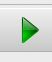

In [12]:
# Chunk 5 in the lower sideband (LSB) and upper sideband (USB)
flagdata(vis=myvis, mode='manual', spw='13:127,22:127', flagbackup=False) # We'll save a flag version after all manual flagging is done
flagdata(vis=myvis, mode='manual', spw='13:143,22:143', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='13:151,22:151', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='13:134~136,22:134~136', flagbackup=False) # Flag a range from 134 to 136

# Chunk 4 in the lower sideband (LSB) and upper sideband (USB)
flagdata(vis=myvis, mode='manual', spw='14:125,21:125', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='14:141,21:141', flagbackup=False)

# Chunk 2 in the lower sideband (LSB) and upper sideband (USB)
flagdata(vis=myvis, mode='manual', spw='16:1536,19:1536', flagbackup=False)
flagdata(vis=myvis, mode='manual', spw='16:1731,19:1731', flagbackup=False)

### Back up a version of the flags we've just added! ####
flagmanager(vis=myvis, mode='save', versionname='manual_flagging_initial')

Once all the spikes have been removed, re-load the plot once more. You should see something similar to this for SPW 12 to 23:

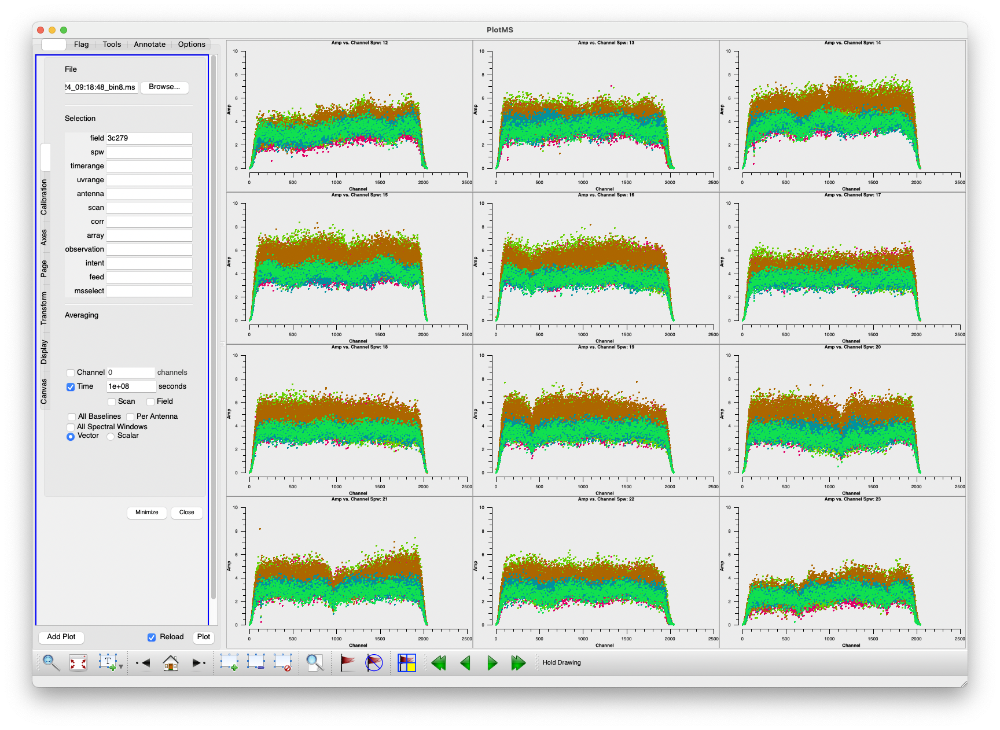

### Flagging edge channels ###

The spectral variations we are left with correspond to a combination of the system response and atmospheric absorption features. We will correct for this with the bandpass.

Near the edge of each 2 GHz SPW, the sensitivity drops off. We will typically flag these edge channels as they become highly noisy. The SMA's spectral coverage is set to mildly overlap between adjacent SPWs, so flagging ~2-3% of the edge channels will still give us continuous spectral coverage across each 12 GHz sideband.

Because the SMA observes with the same number of spectral channels (each with a width of 140 kHz), we can fraction of the percent edges if we know how the data have been downsampled. Natively, each SPW will have 16384 channels. In this tutorial, we have pre-averaged the channels together by a factor of 8.

Here we will flag the outer 2.5% of channels, or a fraction of `0.025`.

In [13]:
# Factor the data have been downsampled by:
rechunk = 8

# Original number of channels is 16384. Divide that by how many we have rechunked.
chan_num = int(16384 / rechunk)

# Set the fraction of channels to flag at each edge.
edgechan_frac = 0.025

# Range of channels to flag at the lower edge
edge_chan_low = int(np.floor(chan_num * edgechan_frac))
# Range of channels to flag at the upper edge
edge_chan_high = int(np.floor(chan_num * (1. - edgechan_frac)))

# Combine into the format that CASA's flagdata will interpret
# To select all SPWs, we use the "*" wildcard.
# Also note that channel counting starts at "0", so we set the upper limit to be `chan_num-1`
edgechan = "*:0~{0};{1}~{2}".format(edge_chan_low,
                                    edge_chan_high, chan_num-1)

print(edgechan)

*:0~51;1996~2047


Compare this channel range to those plotted in plotms as a check.

We can then apply the edge flagging, and save a flag version in case we want to re-run the edge flagging with a different fraction chosen in the cell above.

In [14]:
flagdata(vis=myvis, mode='manual', spw=edgechan, flagbackup=False)
flagmanager(vis=myvis, mode='save', versionname='edge_flagging')

As above, re-load the plot in plotms. You should now see something like this plot for SPW 12 to 23:

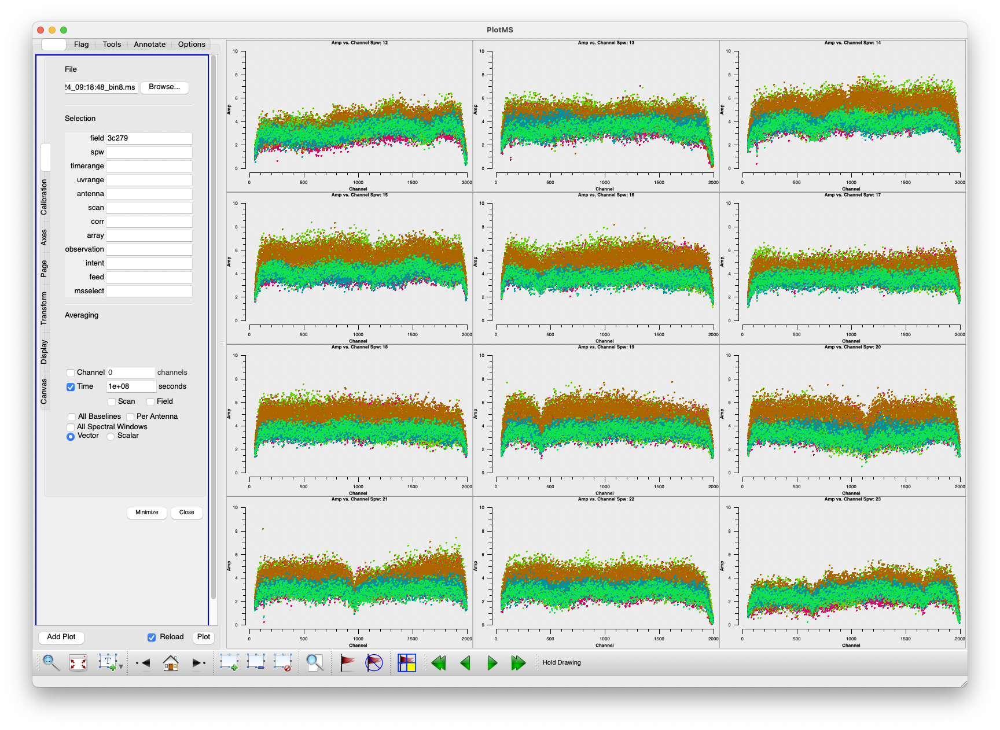

### More manual flagging: Visualizing and flagging for our whole calibrator suite ###

Our bandpass 3C279 is looking cleaned up after the above round of manual flagging. But before moving on to the actual calibration, we should similarly check the other calibrator sources for any other systematic issues.

Below is an abbreviated version above of plotting the amplitude vs. frequency, but looking at the other calibrators. After that, we will also check the amplitude vs. time.

Checking for manual flagging on the flux calibrator Ceres:

**Amplitude vs. frequency**

In [24]:
plotms(vis=myvis, xaxis='channel',
       yaxis='amp',field=flux, avgtime='1e8', avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=4, gridcols=3, yselfscale=True)

In [15]:
# This is an individual channel outlier that only appear in 1 channel, not in both sidebands.
# Based on the color of the points, these outliers are all coming from the same antenna: Ant4
flagdata(vis=myvis, mode='manual', field=flux, spw="10:732", antenna='Ant4', flagbackup=False)

flagdata(vis=myvis, mode='manual', field=flux, spw="13:732,22:732", antenna='Ant4', flagbackup=False)
flagdata(vis=myvis, mode='manual', field=flux, spw="13:1329,22:1329", antenna='Ant4', flagbackup=False)

flagdata(vis=myvis, mode='manual', field=flux, spw="14:124,21:124", antenna='Ant4', flagbackup=False)
flagdata(vis=myvis, mode='manual', field=flux, spw="14:133,21:133", antenna='Ant4', flagbackup=False)
flagdata(vis=myvis, mode='manual', field=flux, spw="14:230,21:230", antenna='Ant4', flagbackup=False)

{}

**Amplitude vs. Time**

This plotms call is close to the one above, but we instead plot time (`xaxis='time'`) and average over frequency (`avgchannel='1e8'`).

*NOTE: you may get warnings the `avgchannel` is larger than actual number of channels. This is OK and can be ignored.*

In [27]:
plotms(vis=myvis, xaxis='time',
       yaxis='amp',field=flux, avgchannel='1e8',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=4, gridcols=3, yselfscale=True)

2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 0 is smaller than specified chanbin 100000000
2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 0
2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 1 is smaller than specified chanbin 100000000
2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 1
2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 2 is smaller than specified chanbin 100000000
2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 2
2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 3 is smaller than specified chanbin 100000000
2023-05-11 13:27:28	WARN	MSTransformManager::initDataSelectionPa

What are we looking for in time? Similar to frequency, we do not expect large outliers, and the amplitude should be roughly constant in time.

In this case, the data looks good in time:

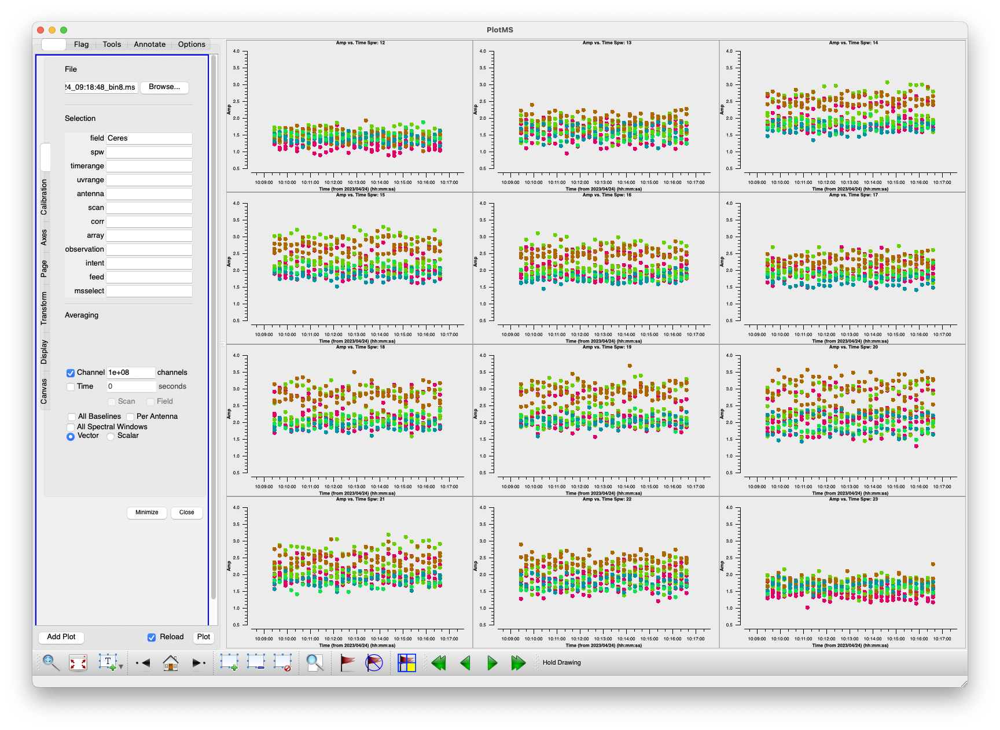

Because Solar System objects are usually resolved by the SMA, it is OK for the amplitude to vary between antennas and baseline pairs. You may see this to some degree on unresolved calibrators, as well, because we have not applied a bandpass to the data yet.

Next, we will check the two gain calibrator, starting with `pcal1`.

**Amplitude vs. Frequency**

In [29]:
plotms(vis=myvis, xaxis='channel',yaxis='amp',
       field=pcal1,
       avgtime='1e8', avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=4, gridcols=3, yselfscale=True)

The gain calibrator has additional frequency spikes that we need to flag. These tend to be systematic, and so have a matched spike between the lower and upper sidebands. These are often the same spikes on both gain calibrators, and similarly affect the science target. Hence, we will flag those channels for all of our sources (*noting that, should those be critical channels for science, such as a spectral line of interest, you would want to investigate the spikes per target to hopefully save that range on the science target*).

As above, add flag commands, then re-load the plot in plotms to see if you have caught all of the spikes (*remember to press the forward "play" button to investigate all 24 SPWS!*).

In [16]:
flagdata(vis=myvis, mode='manual', spw="1:732,10:732", flagbackup=False)
flagdata(vis=myvis, mode='manual', spw="2:132~135,9:132~135", flagbackup=False)
flagdata(vis=myvis, mode='manual', spw="3:1012~1024,8:1012~1024", flagbackup=False)
flagdata(vis=myvis, mode='manual', spw="3:1119,8:1119", flagbackup=False)

flagdata(vis=myvis, mode='manual', spw="13:732,22:732", flagbackup=False)
flagdata(vis=myvis, mode='manual', spw="14:132~135,21:132~135", flagbackup=False)
flagdata(vis=myvis, mode='manual', spw="14:230,21:230", flagbackup=False)

{}

**Amplitude vs. time**

In [38]:
plotms(vis=myvis, xaxis='time', yaxis='amp',
       field=pcal1,
       avgchannel='1e8',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=4, gridcols=3, yselfscale=True)

2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 0 is smaller than specified chanbin 100000000
2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 0
2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 1 is smaller than specified chanbin 100000000
2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 1
2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 2 is smaller than specified chanbin 100000000
2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 2
2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 3 is smaller than specified chanbin 100000000
2023-05-11 16:02:36	WARN	MSTransformManager::initDataSelectionPa

Amplitude vs. time looks fine for `pcal1`: no obvious outliers.

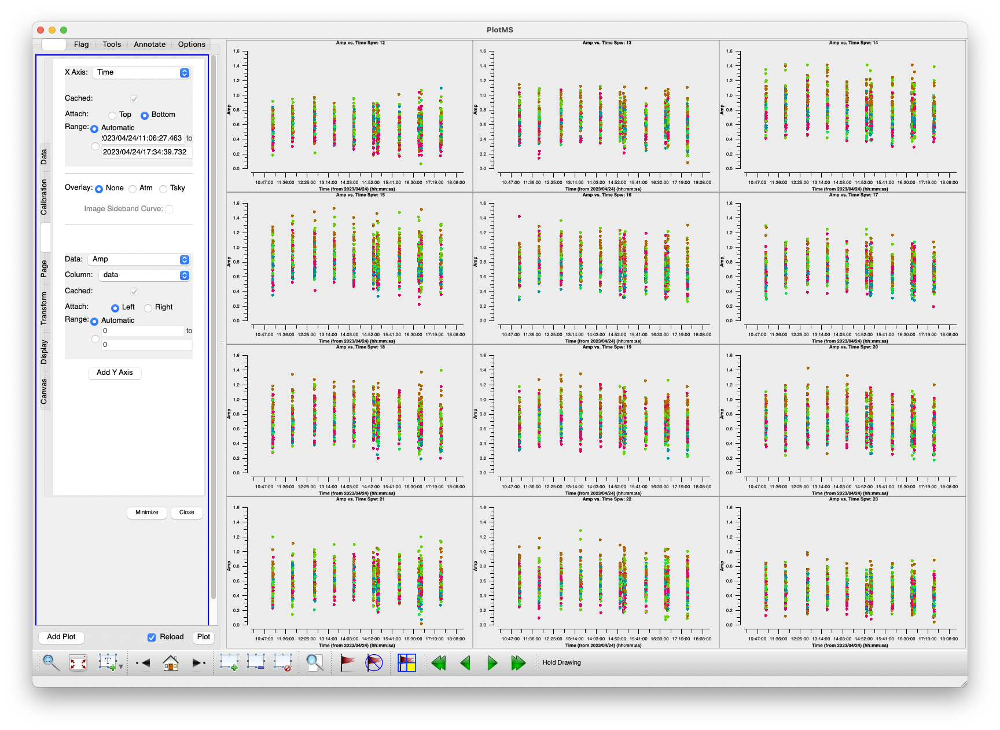

Now `pcal2`:

**Amplitude vs. frequency**

We have more time that was spent on this gain calibrator. As a result, plotms will try to draw more points and use more memory. If plotms is taking a long time to run, you can load a smaller set of SPWs at a time. Here's an example loading only 6 SPWs at a time so we don't hit a memory issue:

In [10]:
plotms(vis=myvis, xaxis='channel',yaxis='amp',
       field=pcal2, spw='0~6',
       avgtime='1e8',
       avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=2, gridcols=3, yselfscale=True)

2023-05-11 17:37:29	WARN	MSTransformManager::parseChanAvgParams	Channel bin is 1 disabling channel average


In [ ]:
plotms(vis=myvis, xaxis='channel',yaxis='amp',
       field=pcal2, spw='7~12',
       avgtime='1e8',
       avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=2, gridcols=3, yselfscale=True)

In [ ]:
plotms(vis=myvis, xaxis='channel',yaxis='amp',
       field=pcal2, spw='13~18',
       avgtime='1e8',
       avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=2, gridcols=3, yselfscale=True)

In [ ]:
plotms(vis=myvis, xaxis='channel',yaxis='amp',
       field=pcal2, spw='18~23',
       avgtime='1e8',
       avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=2, gridcols=3, yselfscale=True)

In [17]:
# Just a single outlier in 1 scan!
flagdata(vis=myvis, mode='manual', spw="14:1783", scan='14', flagbackup=False)

flagdata(vis=myvis, mode='manual', spw="3:253~255,8:253~255", flagbackup=False)


{}

**Amplitude vs. time**

In [7]:
plotms(vis=myvis, xaxis='time', yaxis='amp',
       field=pcal2,
       avgchannel='1e8',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='data',
       gridrows=4, gridcols=3, yselfscale=True)

2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 0 is smaller than specified chanbin 100000000
2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 0
2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 1 is smaller than specified chanbin 100000000
2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 1
2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 2 is smaller than specified chanbin 100000000
2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 2
2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 3 is smaller than specified chanbin 100000000
2023-05-11 17:26:17	WARN	MSTransformManager::initDataSelectionPa

As before, there are not major issues that we find in amplitude vs. time. There is some variability over the course of the night, and the scatter gets larger towards the end reflecting either a higher opacity as the source's elevation decreases (i.e. more atmosphere to look through) or changing weather conditions at that time.

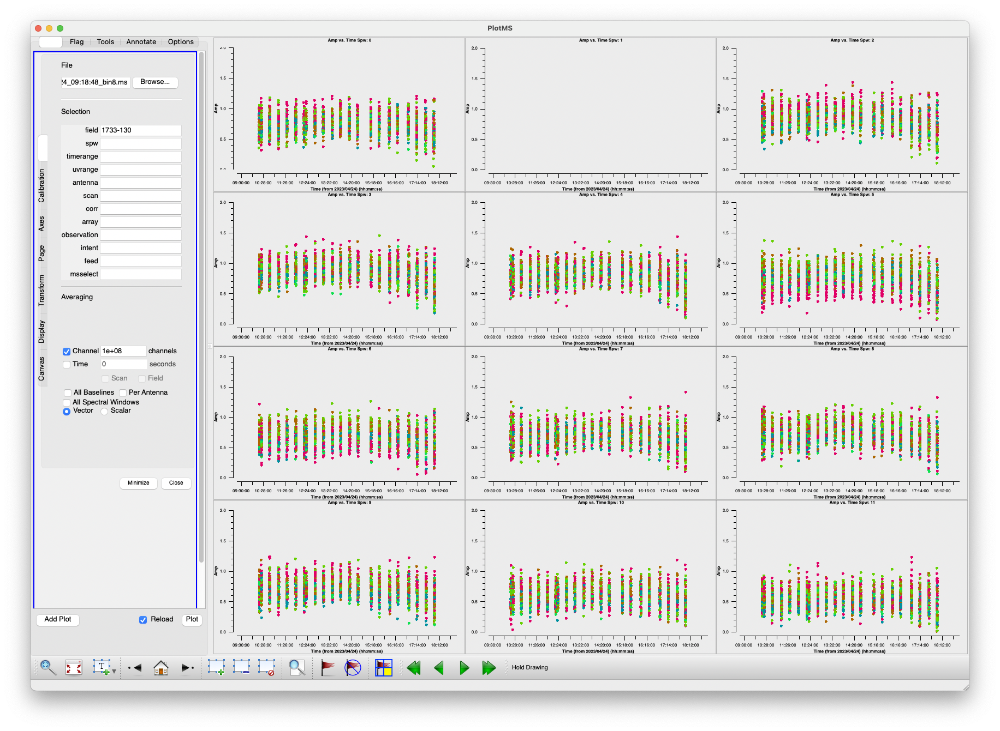

To finish off the manual flagging, we will save another version of the flags in case we want to restart the calibration from the same place.

In [18]:
flagmanager(vis=myvis, mode='save', versionname='manual_flagging_2')

### Set flux calibrator model ###

Absolute flux calibration is applied by comparing with known model for the spectral and spatial properties of the source. In the sub-mm, Solar System objects are often used as absolute flux calibrators, and CASA's [`setjy`](https://casadocs.readthedocs.io/en/stable/api/tt/casatasks.imaging.setjy.html?highlight=setjy) task will read from models shipped with CASA based on the most recent `Butler-JPL-Horizons 2012` set.

In [19]:
setjy(vis=myvis, field=flux, spw='',
      scalebychan=True,
      standard='Butler-JPL-Horizons 2012',
      usescratch=False)

2023-05-11 18:08:02	SEVERE	MeasTable::dUTC(Double) (file casacore/measures/Measures/MeasTable.cc, line 4290)	Leap second table TAI_UTC seems out-of-date.
2023-05-11 18:08:02	SEVERE	MeasTable::dUTC(Double) (file casacore/measures/Measures/MeasTable.cc, line 4290)+	Until the table is updated (see the CASA documentation or your system admin),
2023-05-11 18:08:02	SEVERE	MeasTable::dUTC(Double) (file casacore/measures/Measures/MeasTable.cc, line 4290)+	times and coordinates derived from UTC could be wrong by 1s or more.


{'2': {'0': {'fluxd': array([2.21500635, 0.        , 0.        , 0.        ])},
  '1': {'fluxd': array([2.3105979, 0.       , 0.       , 0.       ])},
  '2': {'fluxd': array([2.30388379, 0.        , 0.        , 0.        ])},
  '3': {'fluxd': array([2.40133619, 0.        , 0.        , 0.        ])},
  '4': {'fluxd': array([2.39449358, 0.        , 0.        , 0.        ])},
  '5': {'fluxd': array([2.4937799, 0.       , 0.       , 0.       ])},
  '6': {'fluxd': array([2.67646742, 0.        , 0.        , 0.        ])},
  '7': {'fluxd': array([2.78109479, 0.        , 0.        , 0.        ])},
  '8': {'fluxd': array([2.77375698, 0.        , 0.        , 0.        ])},
  '9': {'fluxd': array([2.88011074, 0.        , 0.        , 0.        ])},
  '10': {'fluxd': array([2.87265372, 0.        , 0.        , 0.        ])},
  '11': {'fluxd': array([2.9807086, 0.       , 0.       , 0.       ])},
  '12': {'fluxd': array([2.48684025, 0.        , 0.        , 0.        ])},
  '13': {'fluxd': array([2.58

`setjy` returns a dictionary (if it ran successfully) with the flux at the center of each SPW.

### Calibration setup ###

As we defined the purpose of each calibrator source above, we will also define a handful of set variables for using during the calibration steps.

One key one is the reference antenna, which will be (by definition) the phase zero point against which the solutions are derived. We will use `Ant1` as the reference antenna.

*Note: if all of your gain calibration solutions look bad, it may be that your chosen reference antenna has an issue. Try picking a different reference antenna and re-running to see if that corrects the issue.*

`min_solint` is the minimum time to define a solution interval. We will set the default to `int` which is the integration time the data was taken at. For this data set, it is 15 s (see the `listobs` output at the start; the integration times are the list of numbers at the end of each scan description in the first table, which shows `[14.8, 14.8, 14.8...]` or ~15 seconds). *NOTE: SMA data are often taken with 15 or 30 s time integrations. When shorter integration times are used, you may need to set min_solint to a longer time period (e.g., `30s`) to increase the S/N of the time solutions.*


In [20]:
refant = 'Ant1'

min_solint = 'int'

### Bandpass calibration ###

Before solving for the bandpass, we can increase the coherence of the solution by correcting for short term phase variability by performing phase self-calibration on the bandpass calibrator.

In [21]:
# phase-only selfcal
phaseshortgaincal_table = '{0}.bpself.gcal'.format(myvis)
if os.path.exists(phaseshortgaincal_table):
    os.system(f'rm -rf {phaseshortgaincal_table}')

gaincal(vis=myvis,caltable=phaseshortgaincal_table,
        field=bpcal,spw="",refant=refant, scan="",
        calmode='p',
        solint=min_solint,
        minsnr=2.0, minblperant=3,
        gaintable=[])

# Plot the table to inspect the calibration solution
plotms(vis=phaseshortgaincal_table,
       xaxis='time',
       yaxis='phase',
       coloraxis='spw',
       iteraxis='antenna',
       ydatacolumn='data',
       gridrows=3, gridcols=3,
       yselfscale=True,
       xconnector='line', timeconnector=True)

Here we see the phase vs. time. Note that each subplot now shows *per antenna* and the colors corresponds to the SPWs (these are flipped from the plots we made above). Note from the observing log at the beginning that only 6 antennas are in this observation.

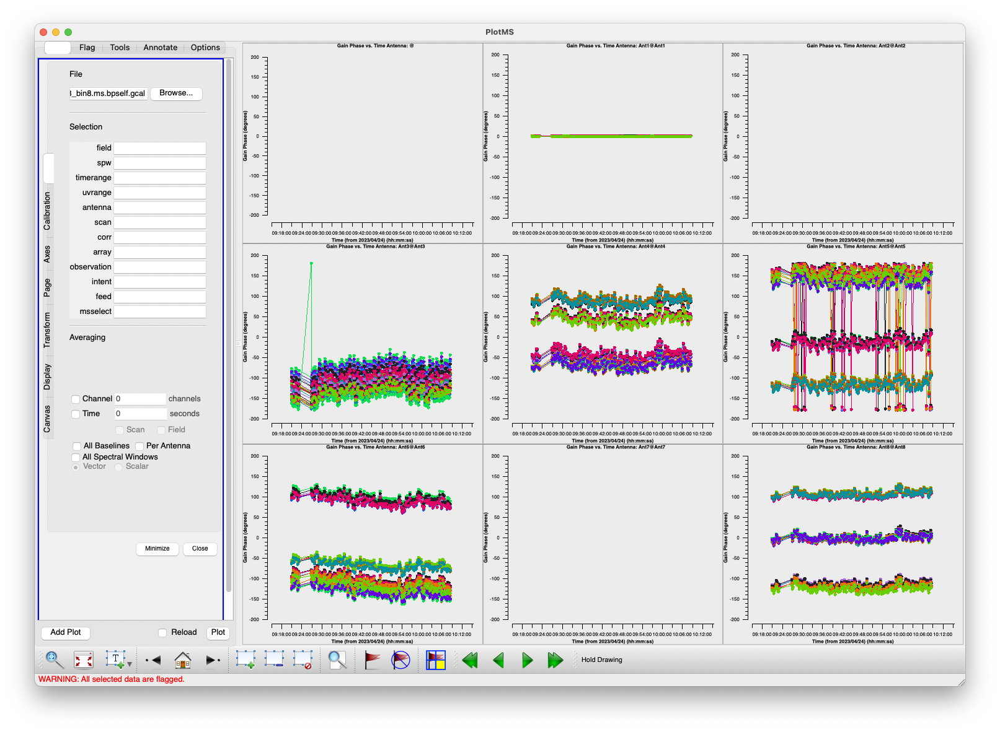

These are fairly well-behaved solutions: there is some short term scatter and longer time variability, but the variations are smooth without large spikes. Note that for Antenna 3, the single spike is from the phases wrapping from -180 to 180.

We will now use this self-calibration phase solution while we solve for the bandpass. In CASA, already-derived calibration tables can be applied on-the-fly to the data using the `gaintable` keyword.

Similar to the `min_solint` that we set above, we can set a time and frequency solution interval to derive the bandpass. Our goal is to maximize the S/N as a function of frequency to derive the bandpass: the spectral response of the telescope.

To do this, we want to use all the time we have on the bandpass source. We can also average a bit in frequency, but not too much or else this will smooth over the variations the bandpass it aimed at capturing.

For SMA data already binned by 8 channels, ~4 channels to average over is a reasonable averaging width. You can play with this range to see the effect and which choice yields an improved bandpass solution for your particular data set.

In [23]:
# Syntax is: time avg., freq avg.
bpsolint = 'inf,4ch'

In [24]:
bandpass_table = '{0}.bandpass.solnorm_true.bcal'.format(myvis)
if os.path.exists(bandpass_table):
    os.system(f'rm -rf {bandpass_table}')

# smooth some channels CHECK SMOOTHING WINDOW
bandpass(vis=myvis,caltable=bandpass_table,
         bandtype='B', scan="",
         field=bpcal, spw="",
         combine='scan,field',
         refant=refant,
         solint=bpsolint, solnorm=True, minblperant=3,
         fillgaps=10,  # If some channels are flagged above, interpolate over in the BP
         gaintable=[phaseshortgaincal_table])


 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=511)
 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=510)
 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=509)
 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=508)
 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=507)
 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=506)
 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=505)
 Insufficient unflagged antennas to proceed with this solve.
   (time=2023/04/24/09:46:06.8 field=1 spw=0 chan=504)
 Insufficient unflagged antennas to proceed with this solve.
   (time=20

Note that we are using the `solnorm=True` option for the bandpass solution. This normalizes the response to 1 per SPW and is useful when we want to combine multiple scans taken at different times, or combine multiple sources of different brightness to increase the S/N of the bandpass.

In [25]:
plotms(vis=bandpass_table,xaxis='freq',
       yaxis='phase',
       coloraxis='spw',iteraxis='antenna',ydatacolumn='data',
       gridrows=3, gridcols=3,
       yselfscale=True,)

QPixmap: It is not safe to use pixmaps outside the GUI thread
QPixmap: It is not safe to use pixmaps outside the GUI thread


Plotting the phase vs. frequency for each antenna's bandpass, colored by the SPW:

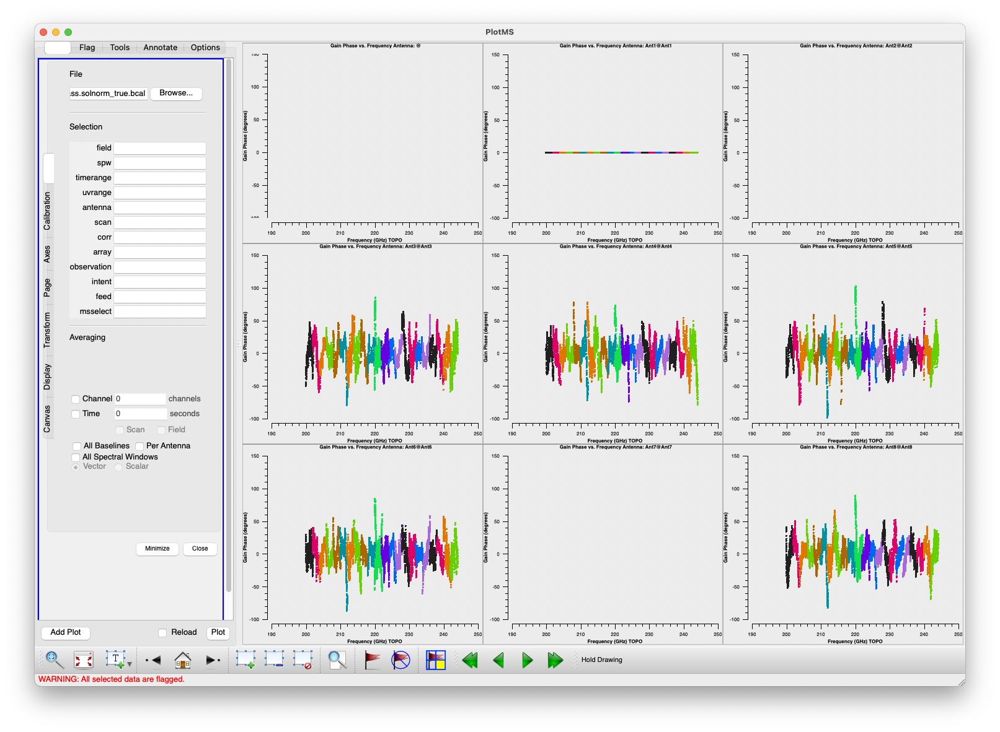

In [26]:
plotms(vis=bandpass_table,xaxis='freq',
       yaxis='amp',
       coloraxis='spw',iteraxis='antenna',ydatacolumn='data',
       gridrows=3, gridcols=3,
       yselfscale=True,)

QPixmap: It is not safe to use pixmaps outside the GUI thread
QPixmap: It is not safe to use pixmaps outside the GUI thread


And the same for amplitude vs. frequency for the bandpass:

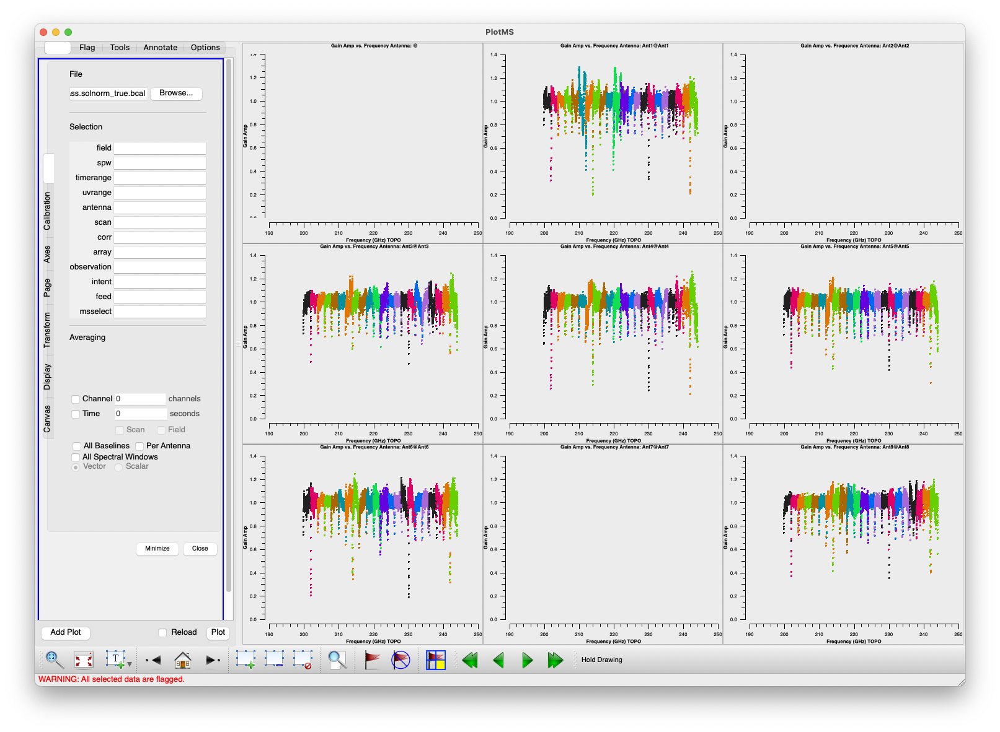

Both solution look reasonable at first glance. Phases are largely centered around zero, as expected for an unresolved point source at the center for the field, and the variations appear smoothly varying across the channels.

Similarly, the amplitudes are normalized to around 1 with smoothly varying response in frequency. The edges are where the sensitivity drops off, giving us the few channels at lower values at the edge of each SPW.

**We will apply the bandpass table with every subsequent calibration solution to correct for the instrumental response. This is the `gaintable=[bandpass_table]` input throughout.**

### Phase Gain Calibration ###

Next we will derive the phase gain calibration. The solutions will be applied to all of the calibrators, but the critical role for the gain calibration is tracking atmospheric or systematic changes in time that we then interpolate onto our science target.

To boost the S/N for the phase gain calibration, we will combine all of the SPWs per side-band in each receiver. We can do reasonably do this because adjacent SPWs (taken by a common receiver) have similar phase variations, which is why a number of the phase solutions for the bandpass self-calibration in the plot above are "grouped" together.

CASA's `gaincal` gives us the ability to combine data in different ways, as well as derive different solutions with separate `gaincal` calls that append to a single calibration table. We will use this functionality here to derive the phase gain solution for each of the 4 sidebands (2 sidebands per receiver).

First, we will derive phase gain solution at our set `min_solint` interval:

In [35]:
# per-int phase with combining spws across sidebands.
gain_phase_int_table = '{0}.intphase_combinespw.gcal'.format(myvis)
if os.path.exists(gain_phase_int_table):
    os.system(f'rm -rf {gain_phase_int_table}')

# Receiver 1 (rx230):
# LSB
gaincal(vis=myvis,caltable=gain_phase_int_table,
        field=calfields,refant=refant,
        combine='spw',spw='0~5',
        calmode='p',solint=min_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])
# USB
# Note the same `caltable` name with `append=True`
gaincal(vis=myvis,caltable=gain_phase_int_table, append=True,
        field=calfields, refant=refant,
        combine='spw',spw='6~11',
        calmode='p',solint=min_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])

# Receiver 2 (rx240):
# LSB
gaincal(vis=myvis,caltable=gain_phase_int_table, append=True,
        field=calfields,refant=refant,
        combine='spw',spw='12~17',
        calmode='p',solint=min_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])
# USB
gaincal(vis=myvis,caltable=gain_phase_int_table, append=True,
        field=calfields, refant=refant,
        combine='spw',spw='18~23',
        calmode='p',solint=min_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])

In [31]:
plotms(vis=gain_phase_int_table,xaxis='time',
       yaxis='phase',
       coloraxis='spw',iteraxis='antenna',ydatacolumn='data',
       xconnector='line', timeconnector=True,
       gridrows=3, gridcols=3,
       yselfscale=True)

QPixmap: It is not safe to use pixmaps outside the GUI thread
QPixmap: It is not safe to use pixmaps outside the GUI thread


Phase vs. time with subplots per antenna and colored by the SPW.

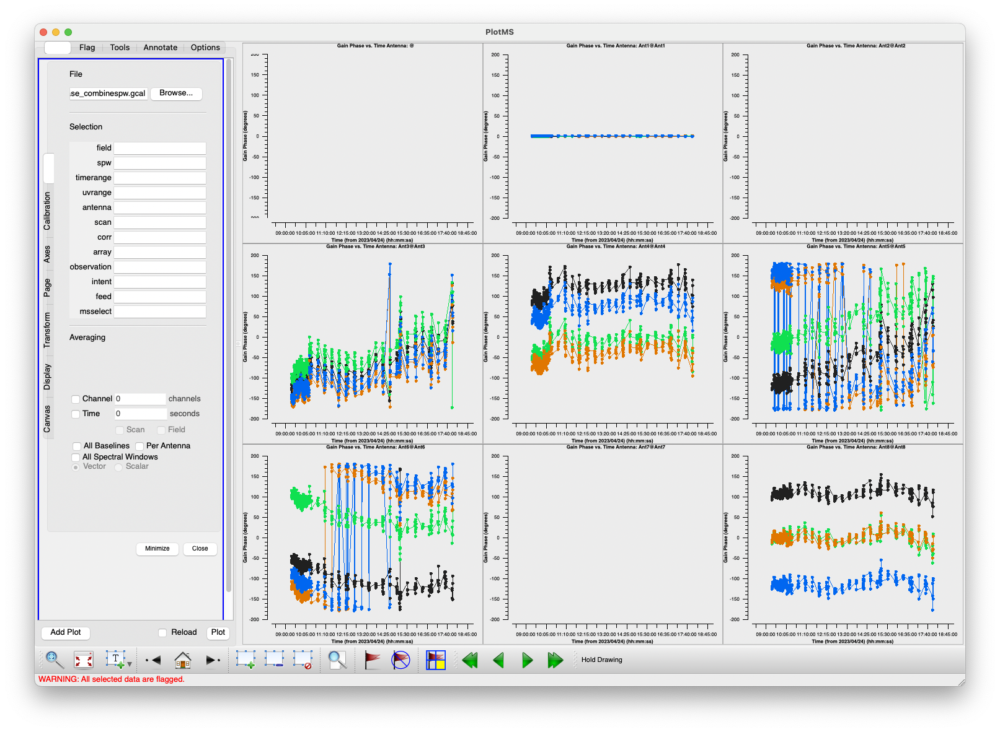

For short time intervals, these solutions are generally quite good. We see 4 different colors corresponding to the 4 sidebands. Most of the changes in phase, apart from the level of scatter, are slow in time, reflecting atmospheric variations.

This short timescale phase gain solution will be applied back to the calibrators themselves as a test to check how good the calibration solutions are.

The phase gain solution that we will apply to the science data are derived using the length of each scan on the calibrators, so combining most of the integrations have on a given source to boost the S/N and reduce the scatter.

We will repeat the same 4 `gaincal`, this time with a solint of `300s`:

In [36]:
long_solint = '300s'

gain_phase_scan_table = '{0}.scanphase_combinespw.gcal'.format(myvis)
if os.path.exists(gain_phase_scan_table):
    os.system(f'rm -rf {gain_phase_scan_table}')
    
# Receiver 1 (rx230):
# LSB
gaincal(vis=myvis,caltable=gain_phase_scan_table,
        field=calfields,refant=refant,
        combine='spw',spw='0~5',
        calmode='p',solint=long_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])
# USB
# Note the same `caltable` name with `append=True`
gaincal(vis=myvis,caltable=gain_phase_scan_table, append=True,
        field=calfields, refant=refant,
        combine='spw',spw='6~11',
        calmode='p',solint=long_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])

# Receiver 2 (rx240):
# LSB
gaincal(vis=myvis,caltable=gain_phase_scan_table, append=True,
        field=calfields,refant=refant,
        combine='spw',spw='12~17',
        calmode='p',solint=long_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])
# USB
gaincal(vis=myvis,caltable=gain_phase_scan_table, append=True,
        field=calfields, refant=refant,
        combine='spw',spw='18~23',
        calmode='p',solint=long_solint,minsnr=2.0,minblperant=3,
        gaintable=[bandpass_table])

In [37]:
plotms(vis=gain_phase_scan_table, xaxis='time',
       yaxis='phase',
       coloraxis='spw',iteraxis='antenna',ydatacolumn='data',
       xconnector='line', timeconnector=True,
       gridrows=3, gridcols=3,
       yselfscale=True)

(per scan) Phase vs. time with subplots per antenna and colored by the SPW.

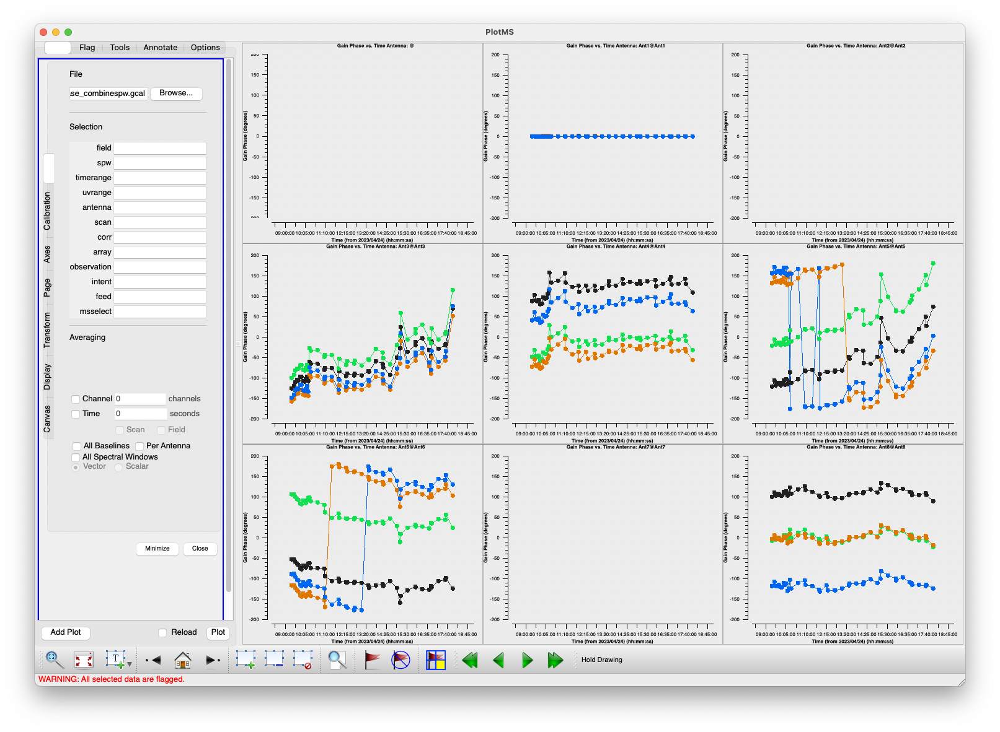

These look similar to the above version, but now with less scatter from averaging a longer timer interval into each solution.

Overall, these phase solutions are quite good. What we are looking for is whether there are abrupt jumps in the phase on short time scales which, when applied to the science data interwoven in time with the gain calibrators, will not produce a coherent solution.

**For a closer look:** we may want to investigate the phase jumps in antenna 3, 5, and 6 around 15:20~15:30. To do this, you could re-run the calibration after having flagged the whole time interval, including the science targets, across the spike. Because the calibration may not give a coherent solution over that time range, the rms in the final image of the science target could be improved.

### Amplitude gain calibration

The next step in gain calibration is to calibrate the amplitudes. For the sub-mm, we expect the amplitude solutions to capture slowly varying systematic variations or residual elevation changes not captured in the system temperatures. Because of this:

* we calibrated the phases first as they tend to vary more quickly, and we will apply the phase correction before solving for the amplitude gains (similar to how we use the bandpass table).
* we will use a longer solution interval time of up to 10 min (or the maximum time per scan, whichever is shorter).

We grouped the sidebands together for the phase gain calibration but will now return to solving the amplitude gains per SPW. This means that we need to tell CASA how to map the sideband phase solutions back to individual SPWs. This is handled by the `spwmap` parameter in the calibration tasks.

For the split tuning setup, the mapping is:

* LSB receiver 1: [0, 0, 0, 0, 0, 0]
* USB receiver 1: [6, 6, 6, 6, 6 ,6]
* LSB receiver 2: [12, 12, 12, 12, 12, 12]
* USB receiver 2: [18, 18, 18, 18, 18, 18]

Or altogether...

In [38]:
this_spwmap = [0, 0, 0, 0, 0, 0, 6, 6, 6, 6, 6 ,6, 12, 12, 12, 12, 12, 12, 18, 18, 18, 18, 18, 18]

The length of this list should match the number of SPWs in the data.

**We will need to pass `this_spwmap` to the `spwmap` keyword in the same order as we give the `gaintable` keyword list. The order is what tells CASA which mapping is for which calibration table.**

*Note if your data is using the dual receiver mode where both receivers are tuned to the same local oscillator frequency (and hence the data set only has 12 SPWs with both polarizations), you only the mapping for "receiver 1" in the above list.*

In [39]:
amp_solint = '10min'

gain_amp_scan_table = '{0}.amp.gcal'.format(myvis)
if os.path.exists(gain_amp_scan_table):
    os.system(f'rm -rf {gain_amp_scan_table}')

gaincal(vis=myvis,caltable=gain_amp_scan_table,
        field=calfields, spw="", refant=refant,
        combine='',
        spwmap=[[],this_spwmap],
        calmode='a', solint=amp_solint, minsnr=3.0, minblperant=3,
        gaintable=[bandpass_table,
                   gain_phase_int_table])


In [40]:
plotms(vis=gain_amp_scan_table, xaxis='time',
       yaxis='amp',
       coloraxis='spw',iteraxis='antenna',ydatacolumn='data',
       xconnector='line', timeconnector=True,
       gridrows=3, gridcols=3,
       yselfscale=True)

Amplitude vs. time with subplots per antenna and colored by SPW:

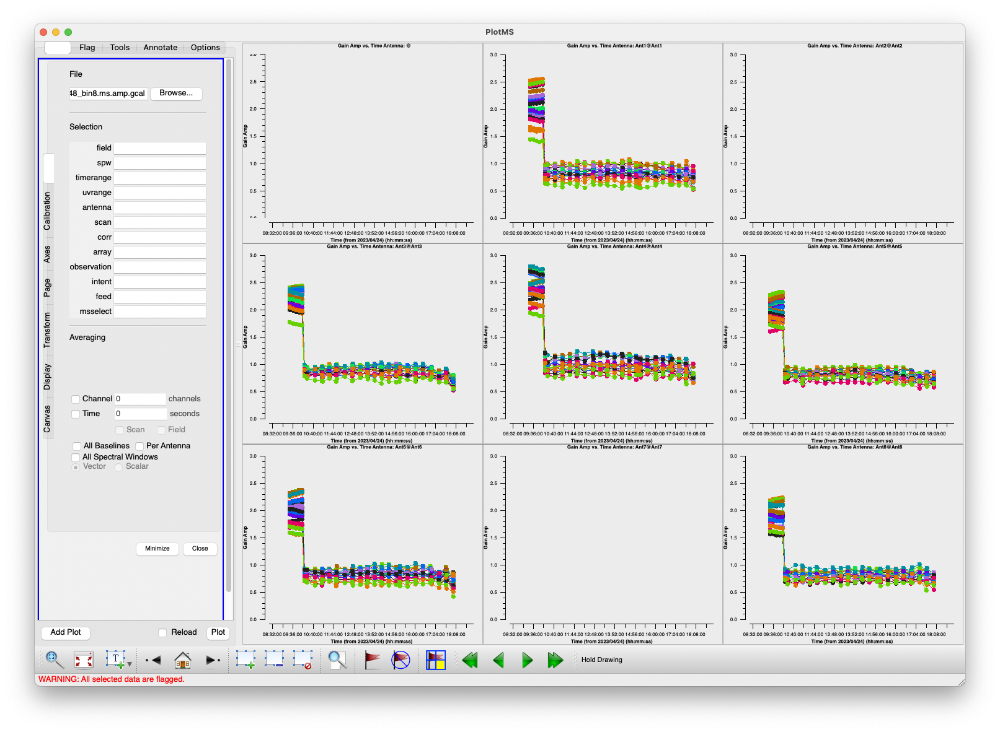

These amplitude solutions look good. Since the $T_{\rm sys}$ correction is applied, the apparent amplitude variations are due to the actual variations in brightness between the different calibrators (e.g. the brighter bandpass source is observed near the beginning of the track). In this case, the two gain calibrators are roughly similar brightness so we do not see significant variation.



In [42]:
plotms(vis=gain_amp_scan_table,
       xaxis='freq', yaxis='amp',
       coloraxis='field',iteraxis='antenna', ydatacolumn='data',
       xconnector='line', timeconnector=True,
       gridrows=3, gridcols=3,
       yselfscale=True)

Amplitude vs. frequency with subplots per antenna and colored by source:

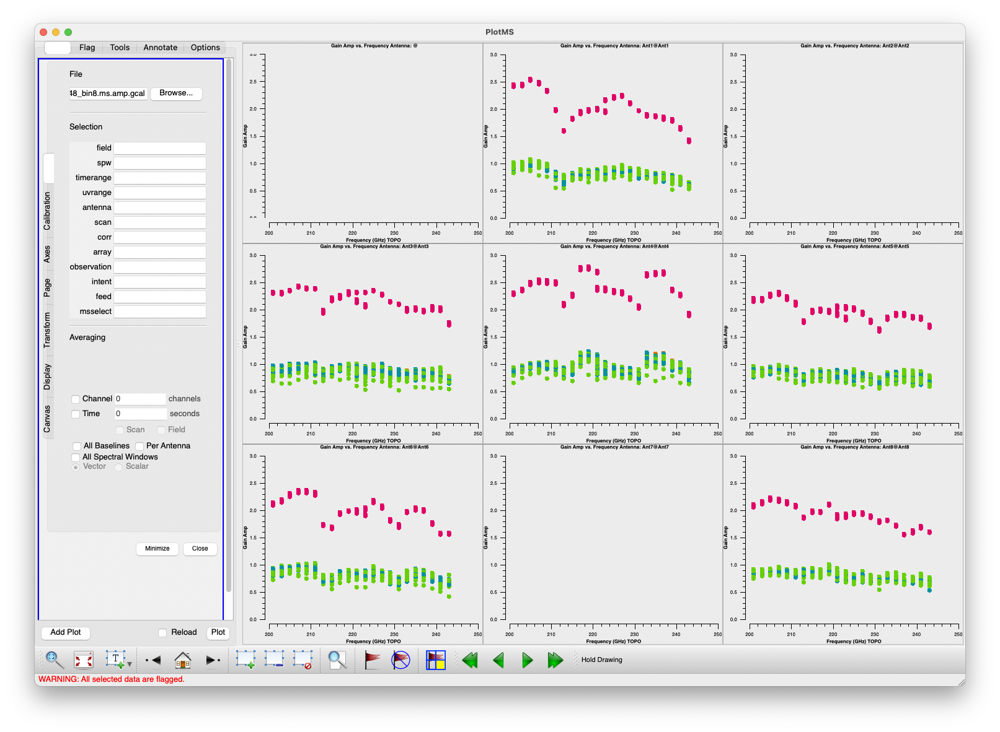

Because the bandpass solution used `solnorm=True`, the amplitude gain calibration captures some frequency variation across the bandwidth. The patterns are similar amongst the different sources, just scaled by how bright the calibrator source is.

### Absolute flux calibration

We will now bootstrap the flux model of the Solar System object (Ceres here) to the calibrators. CASA's [`fluxscale`](https://casadocs.readthedocs.io/en/stable/api/tt/casatasks.calibration.fluxscale.html?highlight=fluxscale) task handles this operation by scaling the relative amplitude gains between the different calibrators.

In [44]:
# Apply to all calibrators except the flux calibrator itself.
transfer_fields = [bpcal, bothpcal]

fluxboot_table = '{0}.flux.cal'.format(myvis)
if os.path.exists(fluxboot_table):
    os.system(f'rm -rf {fluxboot_table}')
        
fluxresults = fluxscale(vis=myvis,
                        caltable=gain_amp_scan_table,
                        refspwmap=[-1],
                        transfer=transfer_fields,
                        fluxtable=fluxboot_table,
                        reference=flux,
                        fitorder=1,
                        incremental=False)

`fluxresults` is a dictionary containing information about the flux scaling applied and the fitted log-polynomial solution. In this case, we fit a linear model (`fitorder=1`) in log-space to the data.

Check the CASA log for an abbreviated summary, and the fitted fluxes to make sure these make sense. A good check is whether the fitted flux is similar to the SMA's flux calibration monitoring list here: http://sma1.sma.hawaii.edu/callist/callist.html **Note that quasars can have rapid (~days) amplitude variations and flares, so one should not necessarily expect a perfect match with the flux monitoring values** (and this is why we do not use quasars for flux calibrators!).

In this case, we get the following from the CASA log:

```
2023-05-11 19:22:48	INFO	fluxscale::::	 Fitted spectrum for 3c279 with fitorder=1: Flux density = 5.80245 +/- 0.0759266 (freq=221.69 GHz) spidx: a_1 (spectral index) =-1.65462 +/- 0.220468 covariance matrix for the fit:  covar(0,0)=7.63188e-07 covar(0,1)=-1.49659e-07 covar(1,0)=-1.49659e-07 covar(1,1)=0.00114865
2023-05-11 19:22:48	INFO	fluxscale::::	 Fitted spectrum for 1733-130 with fitorder=1: Flux density = 0.956143 +/- 0.00471994 (freq=221.69 GHz) spidx: a_1 (spectral index) =-1.01104 +/- 0.0873537 covariance matrix for the fit:  covar(0,0)=2.35106e-05 covar(0,1)=0.000348957 covar(1,0)=0.000348957 covar(1,1)=0.0390328
2023-05-11 19:22:48	INFO	fluxscale::::	 Fitted spectrum for 1743-038 with fitorder=1: Flux density = 0.941525 +/- 0.00416864 (freq=221.69 GHz) spidx: a_1 (spectral index) =-0.974097 +/- 0.0720861 covariance matrix for the fit:  covar(0,0)=1.88628e-05 covar(0,1)=0.000350925 covar(1,0)=0.000350925 covar(1,1)=0.0265104

```

The fitted flux density is reasonable for all sources. The fitted spectral indices are moderately steep at $\sim-1$.

The `fluxboot_table` now contains the appropriate scaling such that we can use it in place of `gain_amp_scan_table` to apply the corrected amplitudes to the science target.

### Applying our calibration solutions

We are now ready to apply the various calibration solutions to the data!

Before doing this, we will do one more flag version backup:

In [75]:
flagmanager(vis=myvis, mode='save', versionname='beforeapplycal')

# Comment out the save command above and run the restoration call to revert to the same flag state.
# flagmanager(vis=myvis, mode='restore', versionname='beforeapplycal')


[`applycal`](https://casadocs.readthedocs.io/en/stable/api/tt/casatasks.calibration.applycal.html?highlight=applycal) is the CASA task the takes the calibration tables and writes out the corrected visbilities to the `CORRECTED` column in the MS file.

We will apply these to the different calibrators, then the science target. This is because we want the ability to use different gain phase solutions and different interpolation scheme for the solutions applied to the science target.

For the bandpass, we will use the solutions applied back to themselves, with the appropriate `spwmap` for the gain phase solutions:

In [47]:
applycal(vis=myvis,field=bpcal,
         spw="",
         gaintable=[bandpass_table,
                    gain_phase_int_table,
                    fluxboot_table], # This order for tables is reflected in `interp`, `spwmap`, and `gainfield`
         interp=['linear,linearflag',
                 'linear,linear',
                 'nearest,linear'], # for each field, this is how to average/interpolate the solutions in "time,freq"
         spwmap=[[], this_spwmap, []],
         gainfield=[bpcal, bpcal, bpcal],
         flagbackup=False,
         calwt=False)

Similar, but now loop through the two gain calibrators:

In [50]:
for pcal in bothpcal.split(","):

    applycal(vis=myvis,field=pcal,
            spw="",
            gaintable=[bandpass_table,
                       gain_phase_int_table,
                       fluxboot_table],
            interp=['linear,linearflag',
                    'linearPD,linear',
                    'nearest,linear'],
            spwmap=[[], this_spwmap, []],
            gainfield=[bpcal, pcal, pcal],
            flagbackup=False, calwt=False)
    

And the flux calibrator:

In [53]:
applycal(vis=myvis,field=flux,
         spw="",
         gaintable=[bandpass_table,
                    gain_phase_int_table,
                    fluxboot_table],
         interp=['nearest','nearestPD','nearest'],
         spwmap=[[], this_spwmap, []],
         gainfield=[bpcal, flux, flux],
         flagbackup=False, calwt=False)

*Finally*, we will apply the solutions to our science target:

In [76]:
applycal(vis=myvis,field=science_fields,
        spw="",
        gaintable=[bandpass_table,
                   gain_phase_scan_table,
                   fluxboot_table],
        interp=['linear,linearflag',
                'linearPD,linear',
                'linear,linear'],
        spwmap=[[], this_spwmap, []],
        gainfield=[bpcal, bothpcal, bothpcal],
        flagbackup=False, calwt=False,
        applymode='calflagstrict')

Note the slight variations in mode and interpolation scheme. For the gain calibration, we linearly interpolate in time between the gain calibrator scans (amplitude and phase).

We also use `calflagstrict` which will flag any data on the science target when a calibration solution failed for part of the data (for example, if one SPW was lost or too noisy to derive a solution for). This ensure that we do not end up with a mixture of calibrated and uncalibrated data for the science target.

In [57]:
flagmanager(vis=myvis, mode='save', versionname='afterapplycal')

The calibration is now complete!

...or is it. The final steps are to check the calibrated visibilities and make test images to ensure the calibration is indeed valid.

## Inspecting calibrated data ##



We will make a handful of plotms calls, similar to those for the manual flagging, to assess the calibration solutions are applied back to the data.

### Bandpass: Amplitude vs. Frequency

Note that we are now using the `corrected` data column!

In [59]:
plotms(vis=myvis, xaxis='channel',
       yaxis='amp',field=bpcal, avgtime='1e8', avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

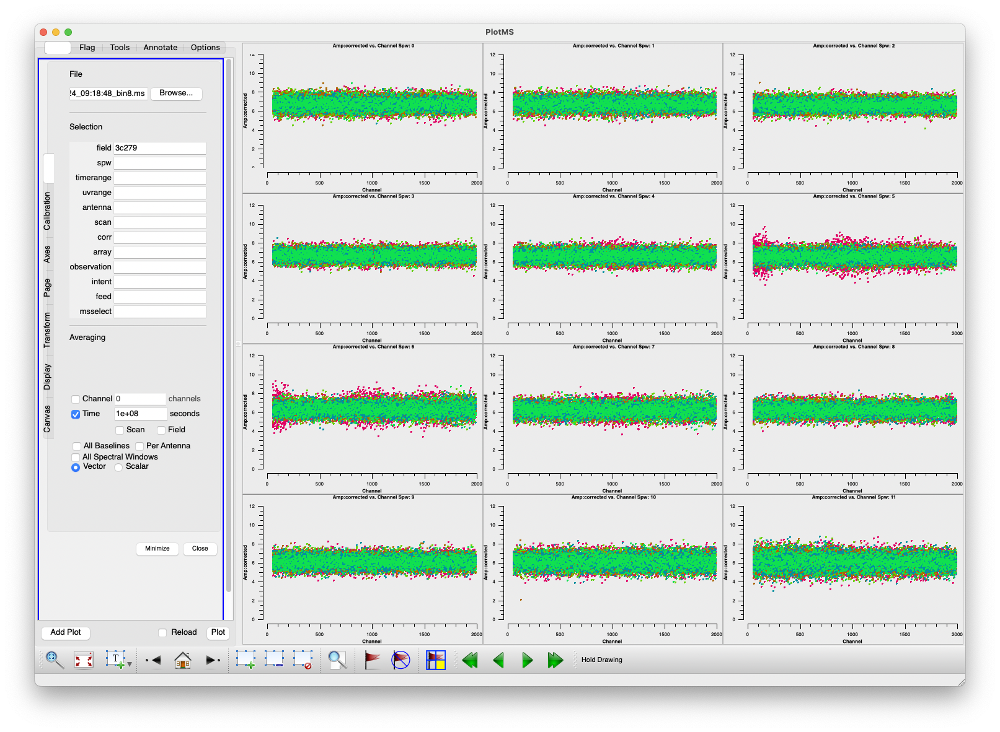

Nearly-flat in amplitude vs. frequency. This is what we expect for a quasar with a simple power-law spectrum.

**Remember to check the next page showing SPW 12 to 23**

In [60]:
plotms(vis=myvis, xaxis='channel',
       yaxis='phase',field=bpcal, avgtime='1e8', avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

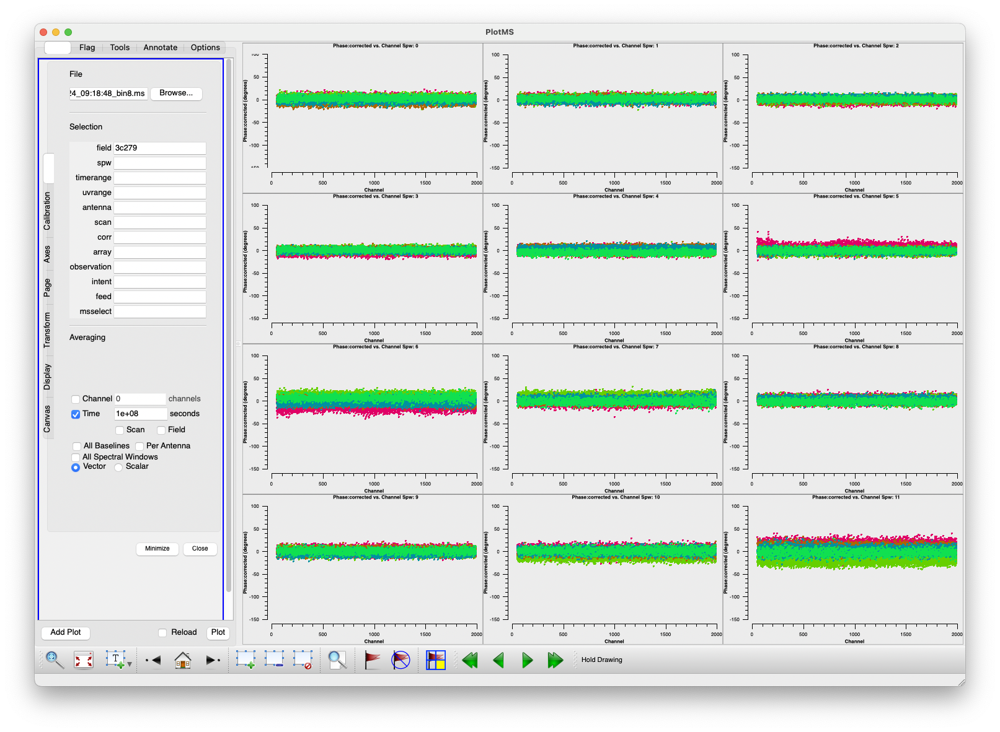

Similarly the phase is flat and centered at zero, as expected for a point source at the center of the field of view. There is moderately more scatter between the outer chunks in each side band (chunks 5 and 6; so for example. SPW 12 and 13). These chunks tend to be moderately noisier so this is expected.

### Bandpass: Amplitude vs. Time

In [61]:
plotms(vis=myvis, xaxis='time', yaxis='amp',
       field=bpcal,
       avgchannel='2048',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 0 is smaller than specified chanbin 100000000
2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 0
2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 1 is smaller than specified chanbin 100000000
2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 1
2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 2 is smaller than specified chanbin 100000000
2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionParams+	Setting chanbin to 2048 for SPW 2
2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionParams	Number of selected channels 2048 for SPW 3 is smaller than specified chanbin 100000000
2023-05-11 20:00:30	WARN	MSTransformManager::initDataSelectionPa

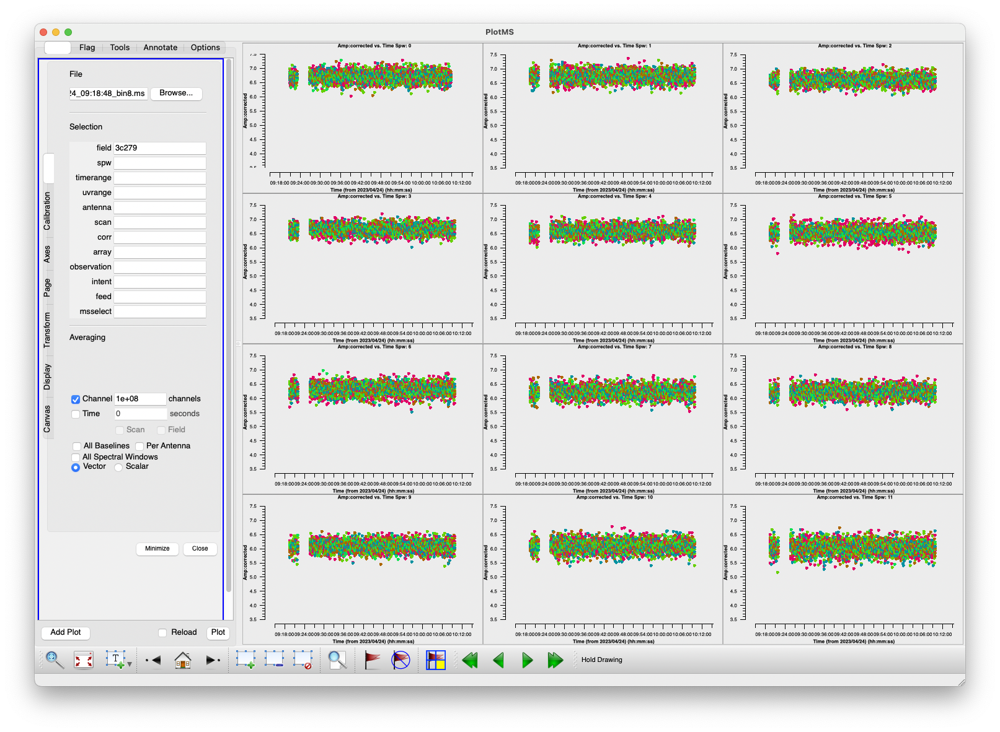

Amplitude vs. time is constant. This is excellent.

### Bandpass: Amplitude vs. uv-distance

In [65]:
plotms(vis=myvis, xaxis='uvdist', yaxis='amp',
       field=bpcal,
       avgchannel='2048', avgtime='300',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

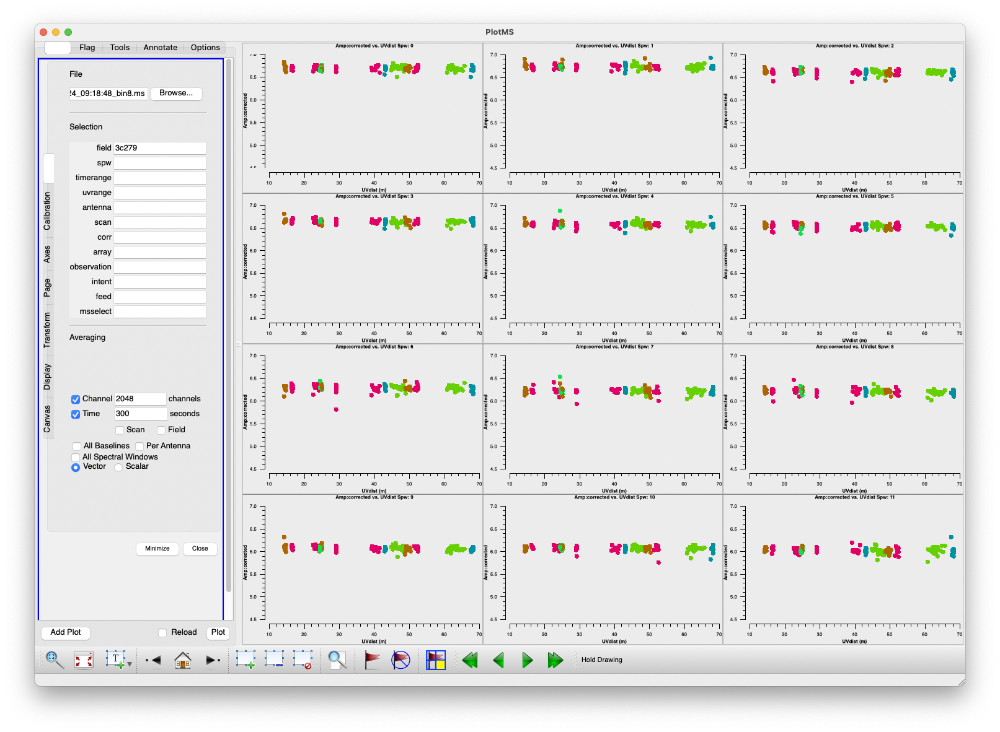

Finally, amplitude vs uv-distance is similarly flat. We expect this for any unresolved source, where the Fourier transform of a delta function is a constant in visibility space.

### Gain calibrators: Amplitude vs. Frequency, Time, uv-distance

Use similar calls to the above for inspecting the other calibrators. Good calibrated data should look similar to the example plots of the bandpass calibrators above.

In [ ]:
# Run each plotms call separately. Do not run the next command until plotms has finished loading and drawing the data

plotms(vis=myvis, xaxis='channel',
       yaxis='amp',field=pcal1, avgtime='1e8', avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)


In [ ]:
plotms(vis=myvis, xaxis='channel',
       yaxis='phase',field=pcal1, avgtime='1e8', avgscan=False,
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)


In [67]:
plotms(vis=myvis, xaxis='time', yaxis='amp',
       field=pcal1,
       avgchannel='2048',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

In [68]:
plotms(vis=myvis, xaxis='uvdist', yaxis='amp',
       field=pcal1,
       avgchannel='2048', avgtime='300',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

And similar for `pcal2`.

### Flux calibrator: Amplitude vs. uv-distance

For `flux`, we are using a Solar System object. These are typically resolved by the SMA so the amplitude vs. uv-distance so we expect the amplitude to decrease with increasing uv-distance as flux is filtered out on finer scales.

To check if the amplitude vs. uv-distance is expected, you can compare the plot below to the [SMA's planetary visibility calculator](http://sma1.sma.hawaii.edu/planetvis.html) for the date of your observation.

In [ ]:
plotms(vis=myvis, xaxis='uvdist', yaxis='amp',
       field=flux,
       avgchannel='2048', avgtime='600',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

Ceres is only marginally resolved in the SMA's compact configuration at ~230 GHz, but the amplitude does indeed descrease at larger uv-distance:

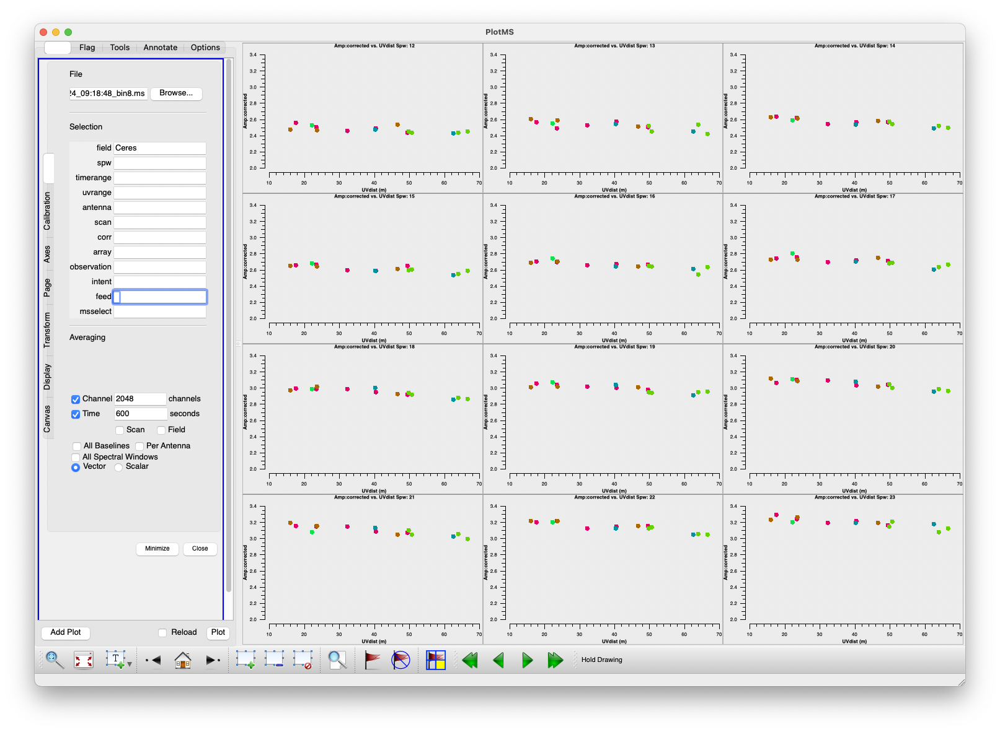

### Target: baseline- and time-averaged spectrum

Lastly, it is useful to inspect the science data itself to search for any systematic issues, or other issues we have not caught in the calibration process.

In [104]:
# Run each plotms call separately. Do not run the next command until plotms has finished loading and drawing the data

plotms(vis=myvis, xaxis='freq',
       yaxis='amp',field=science_fields,
       avgtime='1e8', avgscan=True, avgbaseline=True,
       spw='',
       coloraxis='spw', ydatacolumn='corrected',
       gridrows=1, gridcols=1)

The time- and baseline-averaged spectrum of the science target looks promising!

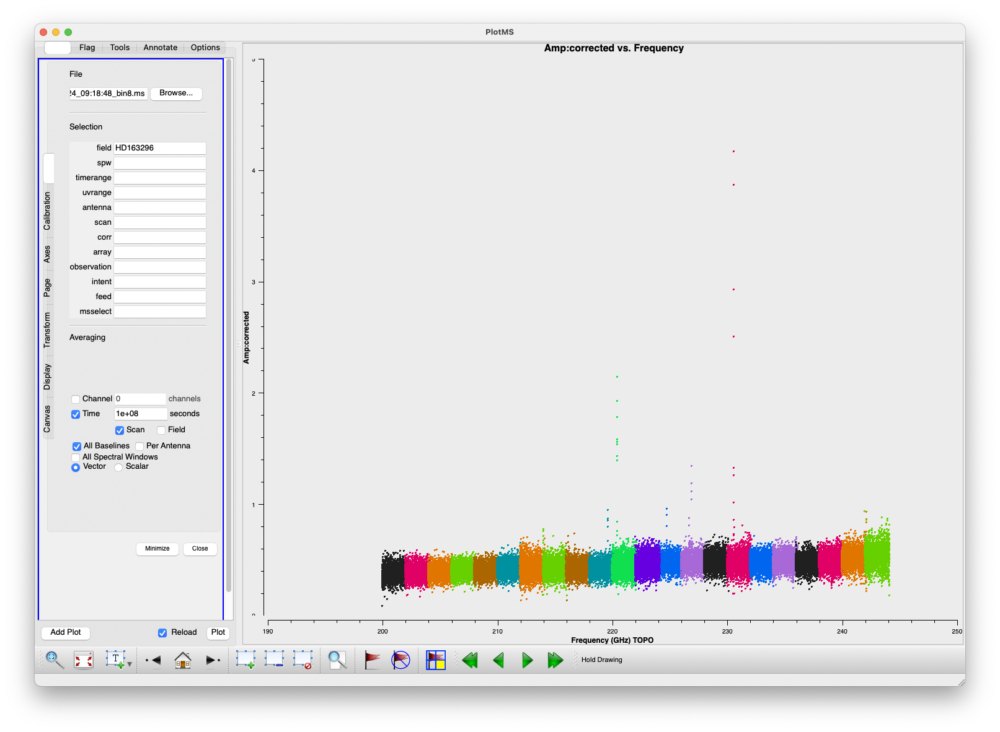

The narrow spikes are spectral lines from the protoplanetary disk.

Here's what the 12CO(2-1) spectra at 230.538 GHz looks like zoomed in:

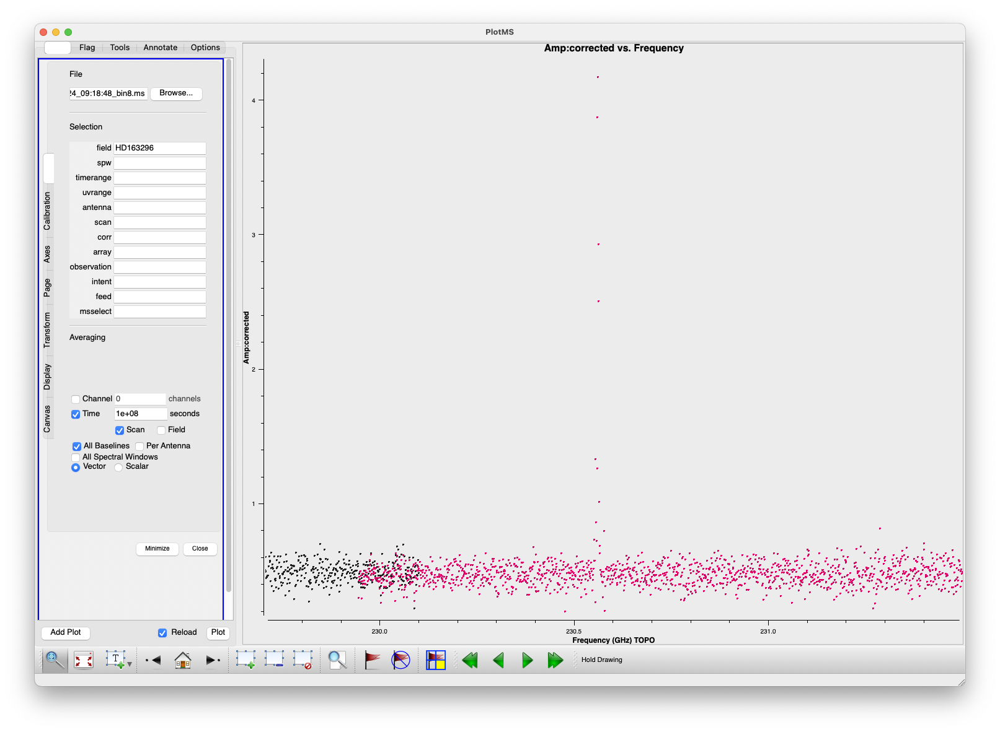

### Target: Amplitude vs. Time

We should also check for any amplitude outliers on the target, in case we also need to manually flag a time interval.

Because the target is (usually) fainter than the calibrators, the amplitudes will simply appear as scatter in the plots. We are looking for any obvious time periods where there are large amplitude outliers, suggesting a systematic issue or a poor calibration solution applied to the data.

In [74]:
plotms(vis=myvis, xaxis='time', yaxis='amp',
       field=science_fields,
       avgchannel='2048',
       coloraxis='ant1',iteraxis='spw', ydatacolumn='corrected',
       gridrows=4, gridcols=3, yselfscale=True)

No more iterations.


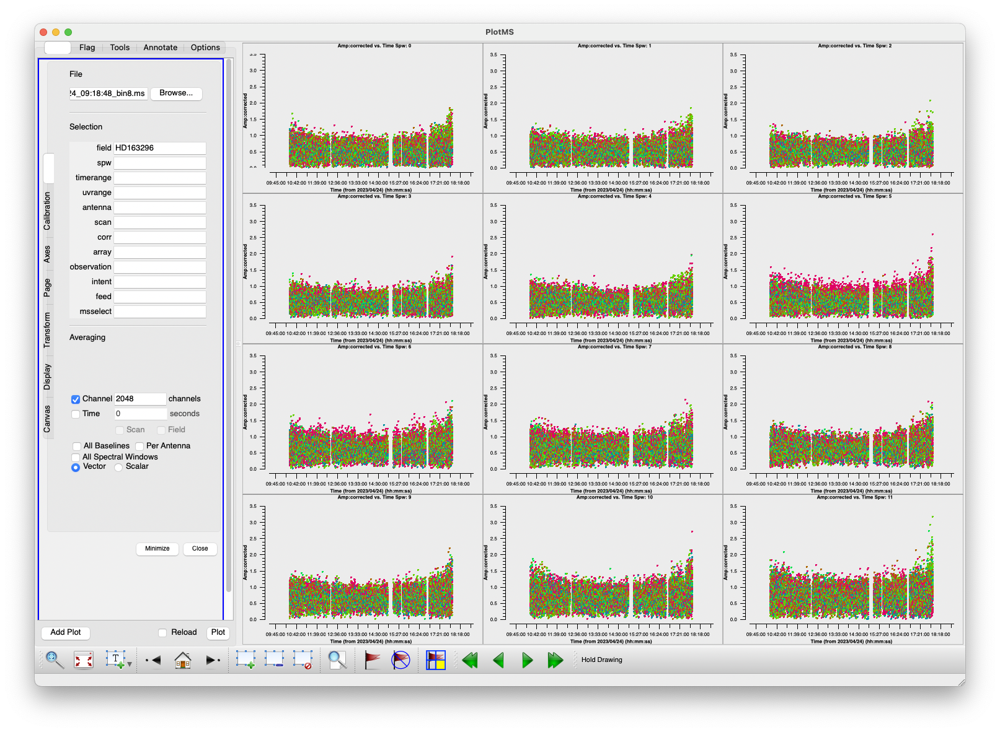

Similar to the gain calibrators, the scatter in the data increases towards the end of the track. Otherwise, we do not see obvious issues (e.g. amplitude spikes).

Overall that are no obvious issues with the calibrated visibilities. We will move on to the final task of making test images as the last check of the calibration.

## Test imaging: calibrators

We will use CASA's [`tclean`](https://casadocs.readthedocs.io/en/stable/api/tt/casatasks.imaging.tclean.html?highlight=tclean) to make test images of the bandpass and gain calibrators. More information on imaging will be provided in the dedicated imaging tutorial.

In [5]:
from casatasks import tclean, rmtables
from casaviewer import imview

from IPython.display import Image

You appear to be importing analysisUtils into python (not CASA). version =  3.8.12
CASAPATH is not defined, so I am skipping a lot of imports


In [6]:
# The bandpass
if os.path.exists(f'{bpcal}_test.psf'):
    rmtables(f'{bpcal}_test.*')
    
tclean(vis=myvis, field=bpcal, imagename=f'{bpcal}_test',
       imsize=128, cell='0.6arcsec', specmode='mfs',
       weighting='briggs', robust=0., niter=0)

2023-05-12 18:19:22	SEVERE	MeasTable::dUTC(Double) (file casacore/measures/Measures/MeasTable.cc, line 4290)	Leap second table TAI_UTC seems out-of-date.
2023-05-12 18:19:22	SEVERE	MeasTable::dUTC(Double) (file casacore/measures/Measures/MeasTable.cc, line 4290)+	Until the table is updated (see the CASA documentation or your system admin),
2023-05-12 18:19:22	SEVERE	MeasTable::dUTC(Double) (file casacore/measures/Measures/MeasTable.cc, line 4290)+	times and coordinates derived from UTC could be wrong by 1s or more.

0%....10....20....30....40....50....60....70....80....90....100%

0%....10....20....30....40....50....60....70....80....90....100%
2023-05-12 18:21:14	WARN	task_tclean::SIImageStore::restore (file src/code/synthesis/ImagerObjects/SIImageStore.cc, line 2246)	Restoring with an empty model image. Only residuals will be processed to form the output restored image.


{}

(0) waiting for viewer process...
	...{'id': 'casaviewer:da53', 'priority': 0, 'types': array(['shutdown', 'image-view', 'interactive-clean'], dtype='<U18'), 'uri': '0.0.0.0:63725'}
 %PGPLOT, Unable to read font file: grfont.dat
 %PGPLOT, Use environment variable PGPLOT_FONT to specify the location of the PGPLOT grfont.dat file.


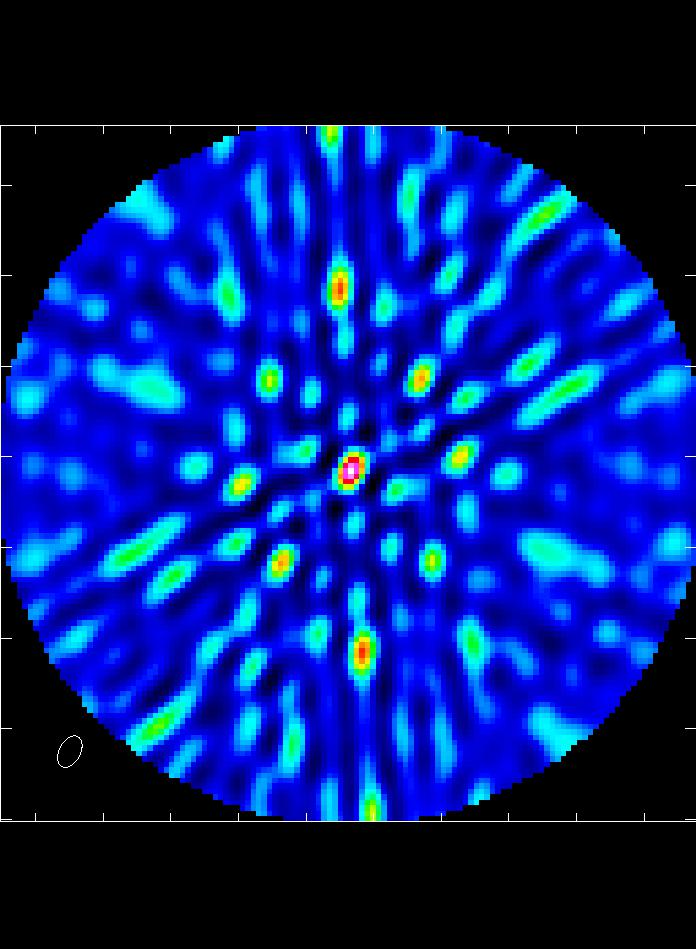

In [7]:
imview(f'{bpcal}_test.image', out=f'{bpcal}_test_image.jpg')

Image(filename=f'{bpcal}_test_image.jpg')

The image looks reasonable: a bright inner point source with sidelobes from the incomplete uv-sampling.

Next do the same for the gain calibrators:

In [8]:
if os.path.exists(f'{pcal1}_test.psf'):
    rmtables(f'{pcal1}_test.*')

tclean(vis=myvis, field=pcal1, imagename=f'{pcal1}_test',
       imsize=128, cell='0.6arcsec', specmode='mfs',
       weighting='briggs', robust=0., niter=0)


0%....10....20....30....40....50....60....70....80....90....100%

0%....10....20....30....40....50....60....70....80....90....100%
2023-05-12 18:26:07	WARN	task_tclean::SIImageStore::restore (file src/code/synthesis/ImagerObjects/SIImageStore.cc, line 2246)	Restoring with an empty model image. Only residuals will be processed to form the output restored image.


{}

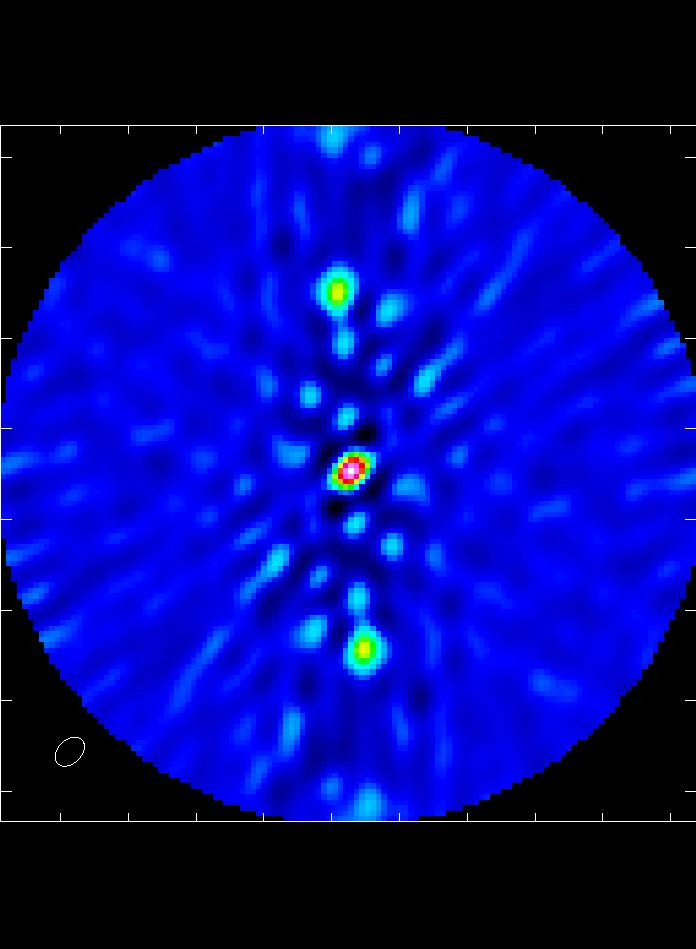

In [9]:
imview(f'{pcal1}_test.image', out=f'{pcal1}_test_image.jpg')

Image(filename=f'{pcal1}_test_image.jpg')

Because we visit the gain calibrators over a larger hour ange range, the PSF structure is better constrained and we get a more obvious looking point source in the image. The additional structure is similarly the PSF sidelobes from the incomplete uv-sampling that an inteferometer provides.

In [10]:
if os.path.exists(f'{pcal2}_test.psf'):
    rmtables(f'{pcal2}_test.*')
        
tclean(vis=myvis, field=pcal2, imagename=f'{pcal2}_test',
       imsize=128, cell='0.6arcsec', specmode='mfs',
       weighting='briggs', robust=0., niter=0)


0%....10....20....30....40....50....60....70....80....90....100%

0%....10....20....30....40....50....60....70....80....90....100%
2023-05-12 18:27:38	WARN	task_tclean::SIImageStore::restore (file src/code/synthesis/ImagerObjects/SIImageStore.cc, line 2246)	Restoring with an empty model image. Only residuals will be processed to form the output restored image.


{}

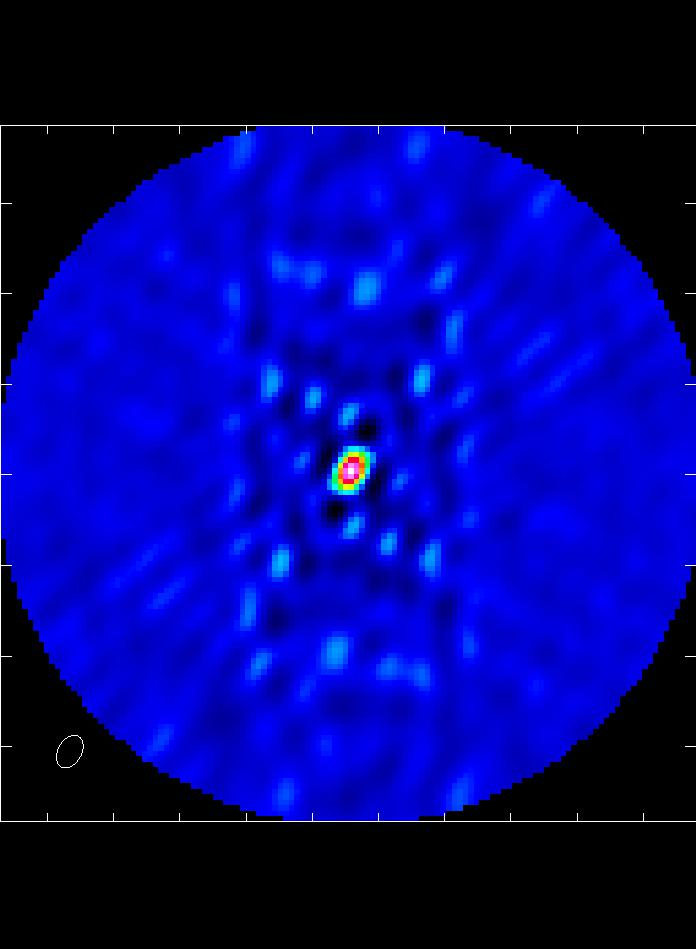

In [11]:
imview(f'{pcal2}_test.image', out=f'{pcal2}_test_image.jpg')

Image(filename=f'{pcal2}_test_image.jpg')

And this gain calibrator as visited more often than `pcal1` and so has an even better constrained PSF structure.

From here, one could deconvolve the PSF from the image to recover the true point source. However, the dirty images are sufficient to demonstrate we recover the expected point source structure and the data is well-calibrated.

## Test imaging: science spectral line and continuum

Lastly we will make example dirty images of our science target.

**NOTE: we will be making quick images without close consideration for excluding spectral line emission from the continuum image, nor subtracting the continuum component from the spectral line imaging. This is for demonstration only, and you would want to account for both when making final science images.**

First, we will make an example "continuum image just to see the structure of our science target (*there's more data on the science target so this may take a bit longer to run*):

In [12]:
# We will loop here to simulate how you would image multiple science targets in a single track:

for this_field in science_fields.split(","):
    print(this_field)

    if os.path.exists(f'{this_field}_continuum_test.psf'):
        rmtables(f'{this_field}_continuum_test.*')
    
    tclean(vis=myvis, field=this_field, imagename=f'{this_field}_continuum_test',
           imsize=128, cell='0.6arcsec', specmode='mfs',
           weighting='briggs', robust=0., niter=0)

HD163296



0%....10....20....30....40....50....60....70....80....90....100%

0%....10....20....30....40....50....60....70....80....90....100%
2023-05-12 18:42:44	WARN	task_tclean::SIImageStore::restore (file src/code/synthesis/ImagerObjects/SIImageStore.cc, line 2246)	Restoring with an empty model image. Only residuals will be processed to form the output restored image.


HD163296


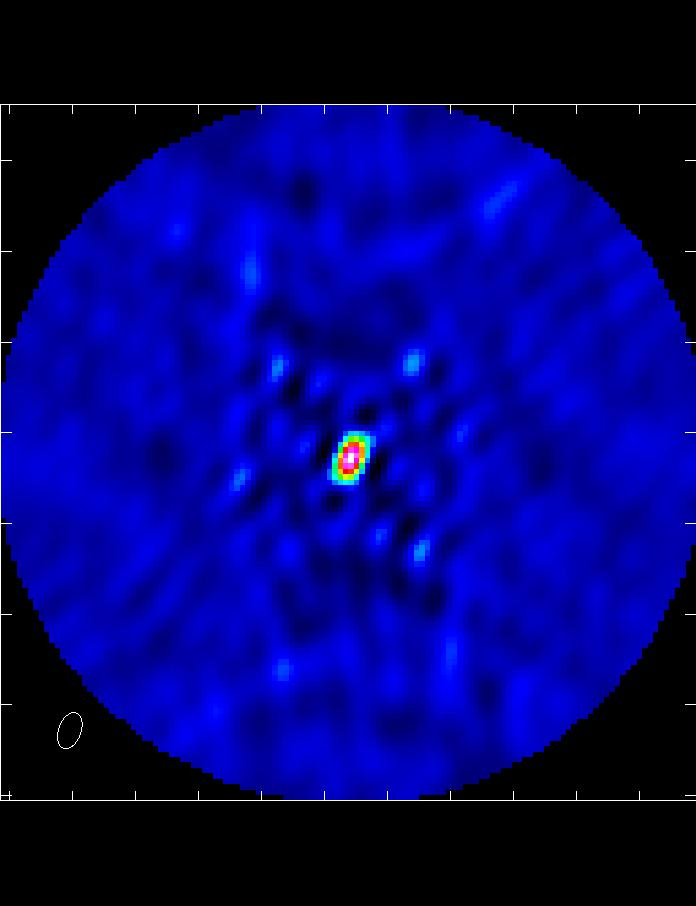

In [13]:
this_field = science_fields.split(",")[0]
print(this_field)
    
imview(f'{this_field}_continuum_test.image', out=f'{this_field}_continuum_test_image.jpg')

Image(filename=f'{this_field}_continuum_test_image.jpg')


The source is marginally resolved at this resolution.

Finally, we will create an example image cube of the $^{12}$CO(2-1) emission:

In [14]:
for this_field in science_fields.split(","):
    print(this_field)

    if os.path.exists(f'{this_field}_12co21_test.psf'):
        rmtables(f'{this_field}_12co21_test.*')
        
    tclean(vis=myvis, field=this_field, imagename=f'{this_field}_12co21_test',
           imsize=128, cell='0.6arcsec', specmode='cube',
           weighting='briggs', robust=0., niter=0,
           spw='11', # found by checking the spectrum visualized in plotms in the "Inspecting calibrated data" section above
           restfreq='230.538GHz', # check on https://splatalogue.online
           start='-20km/s', width='2km/s', nchan=20)

HD163296


2023-05-12 18:42:46	WARN	utils::removetable	Cannot delete file HD163296_12co21_test.jpg because it's not a table.
2023-05-12 18:42:57	WARN	task_tclean::SIImageStore::restore (file src/code/synthesis/ImagerObjects/SIImageStore.cc, line 2246)	Restoring with an empty model image. Only residuals will be processed to form the output restored image.


Because this is an image cube, we will open the interactive image viewer rather than saving a jpg as we did below.

In [15]:
this_field = science_fields.split(",")[0]
print(this_field)
    
imview(f'{this_field}_12co21_test.image',)


HD163296


You should see a few channels with bright 12CO emission. Here is a few example channels:

Channel 12:
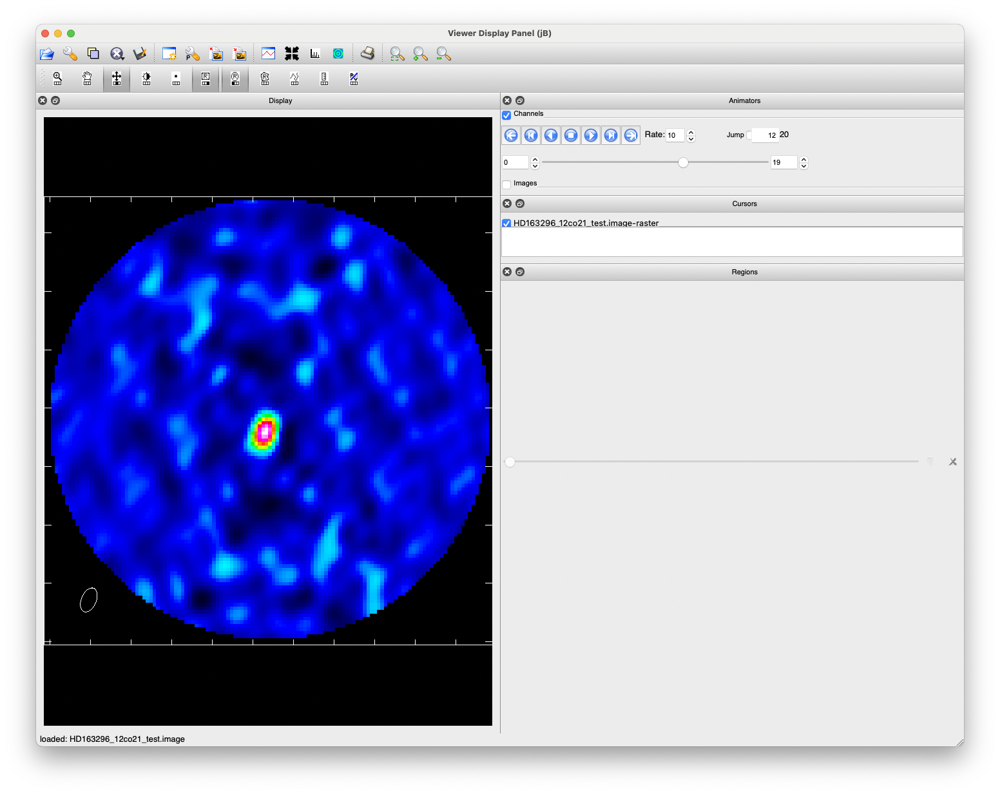

Channel 13:
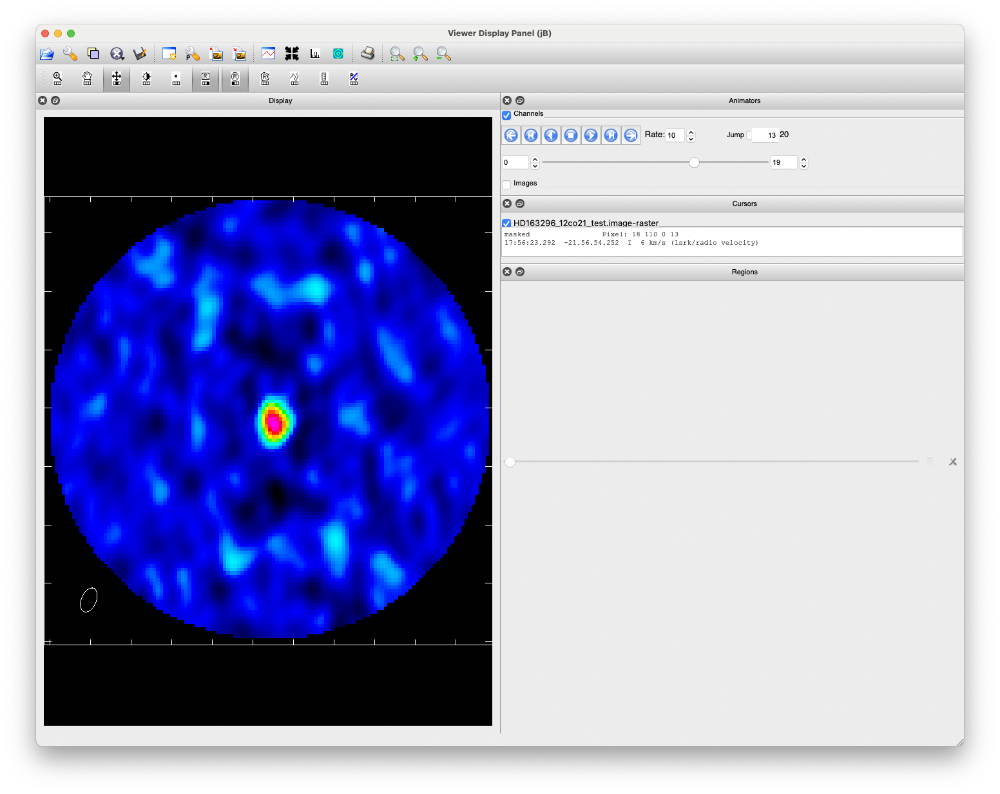

Channel 14:
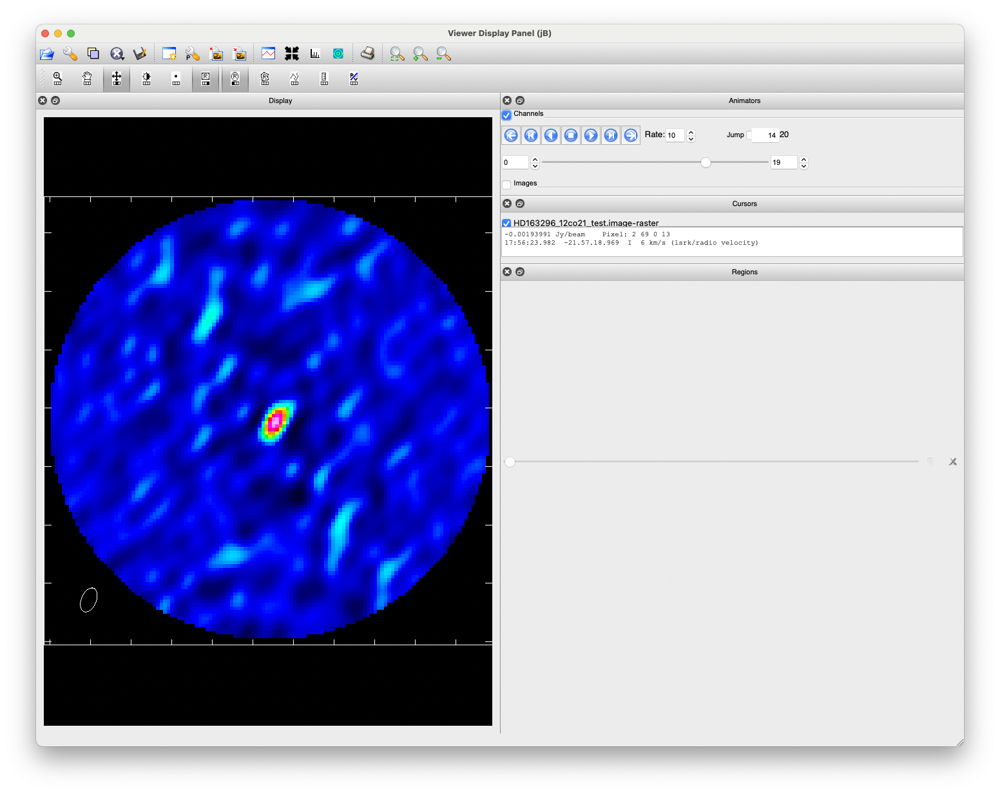


This gives us a (very) coarse view of the blue- and red- doppler shifted CO emission from the disk.

## Next steps

From here, you can split out only the calibrated science data to reduce the size of the data used for imaging later on:

In [ ]:
from casatasks import split

target_vis = "{0}.target".format(myvis)
if os.path.exists(target_vis):
    os.system("rm -r {}".format(target_vis))

split(vis=myvis, outputvis=target_vis,
      field=science_fields, datacolumn='CORRECTED',
      keepflags=False)

Final science images can now be made:

* individual spectral line data cubes after continuum subtracting the line components of the data ([`uvcontsub`](https://casadocs.readthedocs.io/en/stable/api/tt/casatasks.manipulation.uvcontsub.html?highlight=uvcontsub) can be used for this)
* a final continuum image, after excluding frequency ranges where spectral line emission contributed (see the spectrum made in the "Inspecting calibrated data" section).